In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import time
import datetime
import requests
from http import HTTPStatus
import plotly.express as px
from plotly.subplots import make_subplots
import plotly.graph_objects as go
import statsmodels.api as sm
from statsmodels.tsa.stattools import adfuller, acf, pacf
from scipy.stats import kurtosis, skew, shapiro

# formatting character sets for print statements
class format:
    bold = '\033[01m'
    green = '\033[32m'
    red = '\033[31m'
    blue = '\033[34m'
    reset = '\033[0m'

<h1 style="color: #4040a1;">Task 1: Data Collection, Processing, and Resampling</h1>

<h2 style="color: #618685;">1.1 Data Collection: Fetching OHLCV Candlestick Data</h2>

<p><b>Open Price:</b> It is mostly used to decide the trading strategy. For instance, it can be used as a benchmark for trading algorithms, or the difference between the open price and a moving average can be an indicator for generating trades.</p>

<p><b>High & Low Prices:</b> They define range of price movement in a given period and help assess <i>volatility</i>, <i>risk</i>, and <i>trend strength</i>. They indicate support and resistance levels which can help in predicting potential price reversals or trends.</p>

<p><b>Close Price:</b> It is considered the most important price in quantitative finance since it is the final consensus of value for the trading period. In <strong style="color: #3e4444;">time series</strong>, close price is used to study statistical properties of asset prices. It helps in determining the momentum strategy by comparing the difference between the close price of one period and its prior period. In candlesticks, close price is crucial for identifying patterns.</p>

<p><b>Volume:</b> It provides insights into market participation, liquidity, and the strength of price movements. It helps in predicting the slippage in such way that high volume implies low slippage, while low volume can suggest prices move unpredictably.</p>

<h3 style="color: #c83349;">1. Modular Python Functions for API Interactions</h3>

In [2]:
# convert date to unix seconds
def convert_to_unix_sec(Y, m, d, H=0, M=0, S=0):
    dt = datetime.datetime(Y, m, d, H, M, S)
    dt = int(time.mktime(dt.timetuple()))
    return dt

In [3]:
# convert unix timestamp to readable date
def convert_unix_to_date(timestamp):
    return datetime.datetime.fromtimestamp(timestamp).strftime('%Y-%m-%d %H:%M:%S')

In [4]:
# send request to Nobitex server

# handling some http errors
tries = 3
retry_codes = [
    HTTPStatus.TOO_MANY_REQUESTS,
    HTTPStatus.INTERNAL_SERVER_ERROR,
    HTTPStatus.BAD_GATEWAY,
    HTTPStatus.SERVICE_UNAVAILABLE,
    HTTPStatus.GATEWAY_TIMEOUT,
]

def get_nobitex_ohlcv(file_name,
                      symbol, 
                      resolution='60', 
                      start_date=datetime.datetime(2022, 12, 1),
                      end_date=datetime.datetime(2023, 11, 30, 23, 59)
                      ):
    
    # define request url
    base_url = 'https://api.nobitex.ir/'
    end_point = 'market/udf/history'

    # set input parameters for the request
    params = {
        'symbol': symbol,
        'resolution': resolution, # 60 minutes
        'from': convert_to_unix_sec(start_date.year, start_date.month, start_date.day, start_date.hour, start_date.minute),
        'to': convert_to_unix_sec(end_date.year, end_date.month, end_date.day, end_date.hour, end_date.minute)
    }
    
    for n in range(tries):
        try:
            response = requests.get(base_url + end_point, params=params)
            response.raise_for_status()
            
            break
            
        except requests.exceptions.HTTPError as exc:
            code = exc.response.status_code
            if code in retry_codes:
                # sleep for n seconds
                time.sleep(n)
                continue;

            raise
            
    # write data in file
    f = open(file_name, 'w')
    f.write(response.text)
    f.close()

# send the request
get_nobitex_ohlcv(file_name='USDTIRT.json', symbol='USDTIRT')

In [5]:
# create ohlcv dataframe from our downloaded data
def create_ohlcv(file_name):
    df = pd.read_json(file_name)
    # check if data is downloaded without error
    if df['s'].unique() == 'ok':
        df.drop(axis=1, columns='s', inplace=True) # drop the column 
    else:
        return -1
    df.t = df.t.apply(convert_unix_to_date) # convert unix timestamp into date and time
    df = df.set_index('t') # set date column as the index
    return df

usdt_tmn_data = create_ohlcv('USDTIRT.json')
usdt_tmn_data

,o,h,l,c,v
t,,,,,
2022-12-01 00:00:00,36467,36530,36457,36470,169798.392394
2022-12-01 01:00:00,36470,36479,36360,36363,171315.946298
2022-12-01 02:00:00,36360,36400,36261,36265,168666.204563
2022-12-01 03:00:00,36277,36382,36264,36273,92182.941619
2022-12-01 04:00:00,36272,36400,36272,36322,38386.956232
...,...,...,...,...,...
2023-11-30 19:00:00,50777,50848,50720,50755,174815.929862
2023-11-30 20:00:00,50750,50815,50701,50733,164859.035711
2023-11-30 21:00:00,50722,50800,50715,50793,116078.037010


<p style = "font-size: 16px;">Nobitex only provided historical data with 60-minute intervals. In the following, I use the time series provided along with the project.</p>

<h3 style="color: #c83349;">2. Processing OHLCV Data into a Representative Price Series</h3>

<p style = "font-size: 16px;"><b>Single Price Point per Timestamp</b></p>
<ul>
<li>
<p><b style="color: #3e4444;">Close price</b> is considered as the final consensus of the value for the asset and encapsulates the market sentiment by the end of the trading period. In candlestick patterns, it is the most significant for reversal or continuation signals.
Close price is used in <span style="color: #3e4444; font-weight: 600">identifying trends (moving averages), price momentum, technical indicators (e.g. RSI and MACD), and statistical models</span>.</p>
</li>
<li>
<p><b style="color: #3e4444;">Typical price</b> is a more balanced representation of the asset's price over time. </p>
</li>
<li>
<p><b style="color: #3e4444;">VWAP</b> can be used in execution algorithms, is a good indicator of liquidity, and is used in determining the fair value - prices above VWAP may indicate overbought conditions, while prices below VWAP may indicate oversold conditions.</p>
</li>
</ul>

<p style="font-weight: 500">I choose <i>close</i> as the single price point per timestamp since the purpose of this task is to analyze time series, their statistical properties, and the relationship between different time series which are better addressed using close price.</p>

In [6]:
# filter data by date (2022, December 1st to 2023, November 30th)
def filter_df(df):
    # change type of datetime column to datetime64
    df['datetime'] = pd.to_datetime(df['datetime'], format='%Y-%m-%d %H:%M:%S')
    df_filtered = df.loc[(df['datetime'] >= '2022-12-01 00:00:00') & (df['datetime'] <= '2023-11-30 23:59:00')]
    return df_filtered

In [7]:
def clean_ohlcv_data(data, drop_columns):
    # drop non-ohlcv columns
    data.drop(axis=1, columns=drop_columns, inplace=True)

    # sort and filter rows based on date
    data = data.sort_values(by='datetime')
    data = filter_df(data)

    # set datetime column as index
    data = data.set_index('datetime')
    print(data.info())

    # ascertain 1 minute intervals
    data = data.asfreq('1min')

    # check for nan values ('asfreq' method introduced some missing values to our data.)
    print("\n" + format.bold + "Number of missing values:" + format.reset)
    print(data.isna().sum())

    return data

In [8]:
# get the dataset
nobitex = pd.read_csv("Data/usdttmn_m1_nobitex.csv")
nobitex.head()

,datetime,open,high,low,close,volume,exchange,isin
0,2024-03-07 00:00:00,59750.0,59791.0,59730.0,59790.0,5408.721262,nobitex,USDTTMN
1,2024-03-07 00:01:00,59791.0,59791.0,59790.0,59791.0,433.160447,nobitex,USDTTMN
2,2024-03-07 00:02:00,59799.0,59867.0,59790.0,59859.0,4834.524589,nobitex,USDTTMN
3,2024-03-07 00:03:00,59865.0,59867.0,59858.0,59867.0,13559.966394,nobitex,USDTTMN
4,2024-03-07 00:04:00,59865.0,59869.0,59860.0,59865.0,13272.237229,nobitex,USDTTMN


In [9]:
# check values for non-ohlcv features
print(nobitex.exchange.unique())
print(nobitex['isin'].unique())

['nobitex']
['USDTTMN']


In [10]:
nobitex = clean_ohlcv_data(nobitex, ['exchange', 'isin'])

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 525571 entries, 2022-12-01 00:00:00 to 2023-11-30 23:59:00
Data columns (total 5 columns):
 #   Column  Non-Null Count   Dtype  
---  ------  --------------   -----  
 0   open    525571 non-null  float64
 1   high    525571 non-null  float64
 2   low     525571 non-null  float64
 3   close   525571 non-null  float64
 4   volume  525571 non-null  float64
dtypes: float64(5)
memory usage: 24.1 MB
None

Number of missing values:
open      29
high      29
low       29
close     29
volume    29
dtype: int64


In [11]:
nobitex

,open,high,low,close,volume
datetime,,,,,
2022-12-01 00:00:00,36467.0,36468.0,36465.0,36465.0,5974.063485
2022-12-01 00:01:00,36465.0,36469.0,36460.0,36468.0,6227.526841
2022-12-01 00:02:00,36467.0,36469.0,36460.0,36469.0,3903.560000
2022-12-01 00:03:00,36469.0,36470.0,36469.0,36470.0,4380.932760
2022-12-01 00:04:00,36470.0,36475.0,36469.0,36469.0,11059.717240
...,...,...,...,...,...
2023-11-30 23:55:00,50723.0,50760.0,50722.0,50731.0,2236.966529
2023-11-30 23:56:00,50759.0,50760.0,50732.0,50760.0,1905.236525
2023-11-30 23:57:00,50779.0,50779.0,50732.0,50779.0,1355.364283


In [12]:
# check statistical properties of the dataframe
nobitex.describe()

,open,high,low,close,volume
count,525571.000000,525571.000000,525571.000000,525571.000000,525571.000000
mean,49122.754166,49144.339574,49098.526296,49122.581746,3076.310358
std,4422.093464,4424.549057,4418.791019,4422.042196,4294.399486
min,36261.000000,36261.000000,36261.000000,36261.000000,0.000000
25%,48800.000000,48820.000000,48774.500000,48800.000000,804.036570
50%,50201.000000,50230.000000,50182.000000,50201.000000,1901.510000
75%,51699.000000,51713.000000,51668.000000,51698.000000,3788.917432
max,60596.000000,60600.000000,60500.000000,60585.000000,296129.678739


In [13]:
# impute the missing values using forward fill method
for col in nobitex.columns:
    nobitex.loc[:, col] = nobitex.loc[:, col].ffill()
nobitex.isna().any()

open      False
high      False
low       False
close     False
volume    False
dtype: bool

In [14]:
# get tabdeal dataset
tabdeal = pd.read_csv("Data/usdttmn_m1_tabdeal.csv")
tabdeal.head()

,datetime,open,high,low,close,volume,exchange,isin
0,2024-03-07 00:00:00,60001.0,60001.0,60001.0,60001.0,2120.207039,tabdeal,USDTTMN
1,2024-03-07 00:01:00,60001.0,60240.0,60000.0,60000.0,2517.783862,tabdeal,USDTTMN
2,2024-03-07 00:02:00,60000.0,60240.0,60000.0,60240.0,2085.297991,tabdeal,USDTTMN
3,2024-03-07 00:03:00,60240.0,60240.0,60000.0,60240.0,2918.273572,tabdeal,USDTTMN
4,2024-03-07 00:04:00,60240.0,60240.0,60240.0,60240.0,2391.710988,tabdeal,USDTTMN


In [15]:
tabdeal = clean_ohlcv_data(tabdeal, ['exchange', 'isin'])

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 510684 entries, 2022-12-01 00:00:00 to 2023-11-30 23:58:00
Data columns (total 5 columns):
 #   Column  Non-Null Count   Dtype  
---  ------  --------------   -----  
 0   open    510684 non-null  float64
 1   high    510684 non-null  float64
 2   low     510684 non-null  float64
 3   close   510684 non-null  float64
 4   volume  510684 non-null  float64
dtypes: float64(5)
memory usage: 23.4 MB
None

Number of missing values:
open      14915
high      14915
low       14915
close     14915
volume    14915
dtype: int64


In [16]:
tabdeal 

,open,high,low,close,volume
datetime,,,,,
2022-12-01 00:00:00,36461.0,36461.0,36461.0,36461.0,0.000000
2022-12-01 00:01:00,36461.0,36461.0,36461.0,36461.0,0.000000
2022-12-01 00:02:00,36461.0,36461.0,36461.0,36461.0,0.000000
2022-12-01 00:03:00,36461.0,36579.0,36461.0,36579.0,3.037204
2022-12-01 00:04:00,36579.0,36579.0,36579.0,36579.0,3.029696
...,...,...,...,...,...
2023-11-30 23:54:00,50767.0,50767.0,50742.0,50742.0,2089.699022
2023-11-30 23:55:00,50742.0,50767.0,50742.0,50767.0,2238.403620
2023-11-30 23:56:00,50767.0,50767.0,50749.0,50749.0,2142.415019


In [17]:
tabdeal.describe()

,open,high,low,close,volume
count,510684.000000,510684.000000,510684.000000,510684.000000,510684.000000
mean,49152.733148,49160.598070,49145.092578,49152.763079,374.538316
std,4467.240085,4468.295157,4466.113695,4467.206068,1327.183252
min,36400.000000,36400.000000,36400.000000,36400.000000,0.000000
25%,48800.000000,48800.000000,48799.000000,48800.000000,0.000000
50%,50191.000000,50197.000000,50185.000000,50191.000000,0.000000
75%,51800.000000,51805.000000,51800.000000,51800.000000,71.411065
max,62000.000000,62000.000000,61995.000000,62000.000000,70092.498108


In [18]:
# get the index of missing values
idx = tabdeal[tabdeal.close.isna() == True].index
nans = tabdeal.loc[idx]

In [19]:
nans

,open,high,low,close,volume
datetime,,,,,
2023-10-09 00:09:00,NaN,NaN,NaN,NaN,NaN
2023-11-07 17:29:00,NaN,NaN,NaN,NaN,NaN
2023-11-07 17:30:00,NaN,NaN,NaN,NaN,NaN
2023-11-07 17:31:00,NaN,NaN,NaN,NaN,NaN
2023-11-07 17:32:00,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...
2023-11-30 23:48:00,NaN,NaN,NaN,NaN,NaN
2023-11-30 23:49:00,NaN,NaN,NaN,NaN,NaN
2023-11-30 23:52:00,NaN,NaN,NaN,NaN,NaN


In [20]:
# inspect nan values in tabdeal time series since it has a large number of missing values
# gaps_filled = tabdeal['close'].ffill()
# fig = go.Figure()
# fig.add_trace(go.Scatter(x=tabdeal.index.astype(dtype=str),
#                          y=tabdeal['close'],
#                          marker_color='indianred', name='trend'))
# fig.add_trace(go.Scatter(x=tabdeal[tabdeal['close'].isna() == True].index.astype(dtype=str),
#                          y=gaps_filled.loc[tabdeal[tabdeal['close'].isna() == True].index],
#                          mode='markers', marker_size=2, marker_symbol='circle', marker_color='green', name='missing values'))

# fig.update_traces(showlegend=True)
# fig.show()

In [21]:
# since the missing values are scatter and there is not a part where we have missing values for a few days or more
# thus we impute them using forward fill method
for col in tabdeal.columns:
    tabdeal.loc[:, col] = tabdeal.loc[:, col].ffill()
tabdeal.isna().sum()

open      0
high      0
low       0
close     0
volume    0
dtype: int64

In [22]:
wallex = pd.read_csv("Data/usdttmn_m1_wallex.csv")
wallex.head()

,datetime,open,high,low,close,volume,exchange,isin
0,2024-03-07 00:00:00,59886.0,60093.0,59886.0,60093.0,2995.96,wallex,USDTTMN
1,2024-03-07 00:01:00,60093.0,60093.0,59879.0,59879.0,4027.22,wallex,USDTTMN
2,2024-03-07 00:02:00,59877.0,60092.0,59866.0,60022.0,3440.40,wallex,USDTTMN
3,2024-03-07 00:03:00,60022.0,60091.0,59901.0,59903.0,6037.40,wallex,USDTTMN
4,2024-03-07 00:04:00,60080.0,60091.0,59910.0,59910.0,3033.70,wallex,USDTTMN


In [23]:
wallex = clean_ohlcv_data(wallex, ['exchange', 'isin'])

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 524784 entries, 2022-12-01 00:00:00 to 2023-11-30 23:59:00
Data columns (total 5 columns):
 #   Column  Non-Null Count   Dtype  
---  ------  --------------   -----  
 0   open    524784 non-null  float64
 1   high    524784 non-null  float64
 2   low     524784 non-null  float64
 3   close   524784 non-null  float64
 4   volume  524784 non-null  float64
dtypes: float64(5)
memory usage: 24.0 MB
None

Number of missing values:
open      816
high      816
low       816
close     816
volume    816
dtype: int64


In [24]:
wallex.describe()

,open,high,low,close,volume
count,524784.000000,524784.000000,524784.000000,524784.000000,524784.000000
mean,49174.903758,49193.730483,49155.277207,49175.030291,1965.894672
std,4412.440462,4415.331063,4409.030432,4412.554012,3667.803577
min,36338.000000,36339.000000,36321.000000,36321.000000,0.000000
25%,48800.000000,48827.000000,48771.000000,48800.000000,163.520000
50%,50243.000000,50255.000000,50230.000000,50244.000000,763.220000
75%,51715.000000,51732.000000,51701.000000,51716.000000,2230.865000
max,61982.000000,61998.000000,61900.000000,61994.000000,307134.580000


In [25]:
# impute missing values using forward fill method
for col in wallex.columns:
    wallex.loc[:, col] = wallex.loc[:, col].ffill()
wallex.isna().sum()

open      0
high      0
low       0
close     0
volume    0
dtype: int64

In [26]:
print(f"nobitex size: {nobitex.shape}")
print(f"tabdeal size: {tabdeal.shape}")
print(f"wallex size: {wallex.shape}")

nobitex size: (525600, 5)
tabdeal size: (525599, 5)
wallex size: (525600, 5)


In [27]:
# impute the last missing value for tabdeal
tabdeal.loc['2023-11-30 23:59:00'] = tabdeal.loc['2023-11-30 23:58:00']
tabdeal.index = pd.to_datetime(tabdeal.index)

<h3 style="color: #c83349;">3. Extraction of Implied USDT-TMN Price Series</h3>

<p>I download BTC-IRT and BTC-USDT data with 60 minute intervals since 1 minute intervals are not available. So we extract the implied USDT-IRT from 60 minute interval data.</p>
<p>BTC_TMN = BTC_USDT * USDT_TMN</p>

In [28]:
# download BTC-IRT ohlcv data
get_nobitex_ohlcv(file_name='BTCIRT.json', symbol='BTCIRT')
btc_tmn_data = create_ohlcv('BTCIRT.json')
btc_tmn_data

,o,h,l,c,v
t,,,,,
2022-12-01 00:00:00,620967000,620999900,618964000,619009601,2.442106
2022-12-01 01:00:00,619500000,623000000,618964201,620165000,2.131084
2022-12-01 02:00:00,620170000,622906550,618995155,622906550,0.649530
2022-12-01 03:00:00,621350205,623999999,619130950,621846808,1.280229
2022-12-01 04:00:00,621877903,623742611,615300010,616000000,1.045705
...,...,...,...,...,...
2023-11-30 19:00:00,1914990998,1919000000,1908000000,1917200000,0.916019
2023-11-30 20:00:00,1918199999,1918199999,1908000002,1914000000,0.423027
2023-11-30 21:00:00,1914000000,1914835000,1909600002,1914835000,0.475221


In [29]:
# download BTC-USDT ohlcv data
get_nobitex_ohlcv(file_name='BTCUSDT.json', symbol='BTCUSDT')
btc_usdt_data = create_ohlcv('BTCUSDT.json')
btc_usdt_data

,o,h,l,c,v
t,,,,,
2022-12-01 00:00:00,16970.00,17070.00,16878.69,16941.69,0.992265
2022-12-01 01:00:00,17029.90,17110.00,17000.00,17050.01,0.801196
2022-12-01 02:00:00,17110.00,17180.00,17108.29,17140.00,0.482844
2022-12-01 03:00:00,17140.00,17200.00,17032.59,17180.00,1.143701
2022-12-01 04:00:00,17180.00,17200.00,16948.53,16948.54,0.496975
...,...,...,...,...,...
2023-11-30 19:00:00,37724.58,37724.58,37567.00,37660.70,0.130181
2023-11-30 20:00:00,37655.00,37724.46,37572.35,37710.00,0.174477
2023-11-30 21:00:00,37710.00,37725.00,37605.01,37725.00,0.191248


In [30]:
implied_usdt_tmn = (btc_tmn_data['c'] / btc_usdt_data['c']).apply(np.floor)

<Axes: >

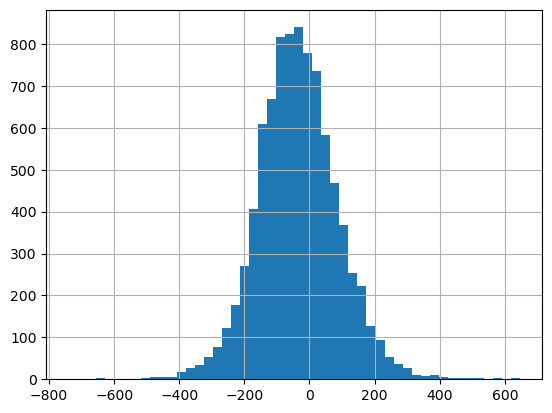

In [31]:
diffs = implied_usdt_tmn - usdt_tmn_data['c']
diffs.hist(bins=50)

<p>implied USDTIRT is not exactly matched to the real values of USDTIRT. We can see there is an error term with gaussian distribution which is expected that when we derive an exchange rate from two other rates, it would introduce an error due to nuances.</p>
<p>BTC_TMN = (BTC_USDT * USDT_TMN) + e</p>

<h2 style="color: #618685;"">1.2 Resampling</h2>

<h3 style="color: #c83349;">1. Selection of Time Scales</h3>

<p style = "font-size: 16px;"><b>Comparison of Different Resampling Methods</b></p>
<ul>
<li>
<p><b style="color: #3e4444;">Close price</b> helps in exploring price trends, high variance and fluctuations (volatility), patterns like breakouts, reversals, and resistance/support levels, correlation with other assets, and cyclic trends.</p>
</li>
<li>
<p><b style="color: #3e4444;">VWAP</b> helps in exploring volume-based trends, fair price levels, high or low liquidity, and the impact of volume levels on the price. It smoothes out price fluctuations and focuses on volume-based trends.</p>
</li>
<li>
<p><b style="color: #3e4444;">TWAP</b> smoothes long-term trends and avoids volatility. It is not sensitive to high-volume price swings so it can provide us with the general market direction. It is specially better for stable markets to present the behavior of an asset over time.</p>
</li>
</ul>

<p style="font-weight: 500">I choose <i>VWAP</i> as the resampling method since it incorporates information from previous prices and is aligned with our analysis goals.</p>

In [32]:
# VWAP
def calculate_vwap(df):
    typical_price = df[['high', 'low', 'close']].mean(axis=1)
    volume_weighted_price = df['volume'] * typical_price
    # avoid deviding by zero
    if df.volume.sum() == 0:
        vwap = np.nan
    else:
        vwap = volume_weighted_price.sum() / df['volume'].sum()
    return vwap

In [33]:
resampling_periods = ['5min', '20min', '1h', '1D']
nobitex_resampled = []
tabdeal_resampled = []
wallex_resampled = []

for i in range(len(resampling_periods)):
    nobitex_resampled.append(pd.DataFrame(nobitex.resample(resampling_periods[i]).apply(calculate_vwap), columns=['vwap']))
    tabdeal_resampled.append(pd.DataFrame(tabdeal.resample(resampling_periods[i]).apply(calculate_vwap), columns=['vwap']))
    wallex_resampled.append(pd.DataFrame(wallex.resample(resampling_periods[i]).apply(calculate_vwap), columns=['vwap']))

In [34]:
# save a copy of each time series
nobitex_copy = []
tabdeal_copy = []
wallex_copy = []
for i in range(len(resampling_periods)):
    nobitex_copy.append(nobitex_resampled[i].copy())
    tabdeal_copy.append(tabdeal_resampled[i].copy())
    wallex_copy.append(wallex_resampled[i].copy())

In [35]:
print(f"nobitex time scale sizes: {nobitex_resampled[0].shape}, {nobitex_resampled[1].shape}, {nobitex_resampled[2].shape}, {nobitex_resampled[3].shape}")
print(f"tabdeal time scale sizes: {tabdeal_resampled[0].shape}, {tabdeal_resampled[1].shape}, {tabdeal_resampled[2].shape}, {tabdeal_resampled[3].shape}")
print(f"wallex time scale sizes: {wallex_resampled[0].shape}, {wallex_resampled[1].shape}, {wallex_resampled[2].shape}, {wallex_resampled[3].shape}")

nobitex time scale sizes: (105120, 1), (26280, 1), (8760, 1), (365, 1)
tabdeal time scale sizes: (105120, 1), (26280, 1), (8760, 1), (365, 1)
wallex time scale sizes: (105120, 1), (26280, 1), (8760, 1), (365, 1)


In [36]:
# visualize time series with different frequencies
def visualize_series(series):
    fig = make_subplots(rows=4, cols=1,
                       subplot_titles=(resampling_periods))
    
    for i in range(len(series)):
        fig.add_trace(go.Scatter(x=series[i].index.astype(dtype=str), 
                                y=series[i]['vwap'],
                                marker_color='indianred'), row=i+1, col=1)
    fig.update_layout(title_text="Resampled Time Series",
                      height=1000,
                      showlegend=False)
    fig.show()

<h4>Nobitex Visualization</h4>

In [37]:
# visualize Nobitex time series
visualize_series(nobitex_resampled)

<h4>Tabdeal Visualization</h4>

In [38]:
# visualize Tabdeal time series
visualize_series(tabdeal_resampled)

<h4>Wallex Visualization</h4>

In [39]:
# visualize Wallex time series
visualize_series(wallex_resampled)

<h2 style="color: #618685;"">1.3 Handling Market Anomalies</h2>

<h3 style="color: #c83349;">1. Missing Data</h3>

In [40]:
# check for missing values introduced by calculating vwap
print("Number of missing values")
for i in range(len(resampling_periods)):
    print(f"{resampling_periods[i]}\nNobitex: {nobitex_resampled[i]['vwap'].isna().sum()}\
        \nTabdeal: {tabdeal_resampled[i]['vwap'].isna().sum()}\nWallex: {wallex_resampled[i]['vwap'].isna().sum()}")

Number of missing values
5min
Nobitex: 21        
Tabdeal: 18055
Wallex: 440
20min
Nobitex: 3        
Tabdeal: 712
Wallex: 13
1h
Nobitex: 0        
Tabdeal: 18
Wallex: 1
1D
Nobitex: 0        
Tabdeal: 0
Wallex: 0


In [41]:
# inspect nan values with green-colored circles for tabdeal 5min time series (since it has a large number of missing values)
# tabdeal_gaps_filled = tabdeal_resampled[0]['vwap'].ffill()
# fig = go.Figure()
# fig.add_trace(go.Scatter(x=tabdeal_resampled[0].index.astype(dtype=str),
#                          y=tabdeal_resampled[0]['vwap'],
#                          marker_color='indianred', name='trend'))
# fig.add_trace(go.Scatter(x=tabdeal_resampled[0][tabdeal_resampled[0]['vwap'].isna() == True].index.astype(dtype=str),
#                          y=tabdeal_gaps_filled.loc[tabdeal_resampled[0][tabdeal_resampled[0]['vwap'].isna() == True].index],
#                          mode='markers', marker_size=1, marker_symbol='circle', marker_color='green', name='missing values'))

# fig.update_traces(showlegend=True)
# fig.show()

We observe that the missing values for tabdeal 5min time series is scatterd along the one year interval and there is no part where we have missing values for a long period such as a few days. So we fill the missing values for all the time series using forward fill method.

In [42]:
# fill missing values using forward fill method
for i in range(len(resampling_periods)):
    nobitex_resampled[i]['vwap'] = nobitex_resampled[i]['vwap'].ffill()
    tabdeal_resampled[i]['vwap'] = tabdeal_resampled[i]['vwap'].ffill()
    wallex_resampled[i]['vwap'] = wallex_resampled[i]['vwap'].ffill()

<h3 style="color: #c83349;">2. Outlier Detection and Correction</h3>

<p style="font-size: 16px"><b>Data Integrity Assurance</b></p>
<ul>
<li>
<p><b style="color: #3e4444;">Rolling Z-score:</b> This method measures how many standard deviations a data point is from the mean. A large z-score (positive or negative) indicates that the data point is far from the mean, and it could be considered an outlier. </p>
</li>
<li>
<p><b style="color: #3e4444;">Simple Moving Average:</b> Averages values over a specified period considering equal weights for all data points. It is less sensitive to recent fluctuations, and is able to detect large deviations over time.</p>
</li>
<li>
<p><b style="color: #3e4444;">Exponential Moving Average</b> It is a weighted moving average that gives more importance to recent data points. It better captures short-term trends and volatility, and detects sudden spikes or drops.</p>
</li>
</ul>

<p style="font-weight: 500">Since these methods assume underlying distributions, we go through each data points and evaluate if it is an outlier or not by comparing the price difference from its pervious and next values.</p>

In [43]:
def detect_outliers(price_list, threshold):
    """ This function goes through a list of price points and computes the simple returns. Then, by comparing the previous and the next
        adjacent returns of a point to a specific threshold, it decides if that point is an outlier or not.
        In case of an outlier, the previous and the next adjacent returns of a point should be greater than the threshold and be of 
        opposite signs.
    """
    # define an anomaly flag so that when a point is suspicious of being an outlier, the flag is on.
    anomaly = False
    sign = 0 # to compare the signs of the previous and the next adjacent simple returns of a point.
    outliers = []
    for i in range(len(price_list)-1):
        current = price_list[i] # get the current price
        next = price_list[i+1] # get the next price
        prop = (next - current)/current # compute return between the current and the next price
        # if anomaly flag is True, then the index i may be an outlier if the return is greater than threshold and of opposite sign compared to the previous return
        if anomaly and (np.abs(prop) > threshold):
            if (sign == 1 and prop < 0) or (sign == -1 and prop > 0):
                outliers.append(i)
                # reset flags
                anomaly = False
                sign = 0
                continue
        sign = 0
        anomaly = False
        # if return is greater than threshold, set the anomaly flag to True, so that in the next round, the function will check the price point for anomaly
        if np.abs(prop) > threshold:
            anomaly = True
            sign = 1 if prop > 0 else -1

    return outliers

Tabdeal 5min data had many missing values after resampling (~18000 points). We filled the missing values using forward fill method and the resultant data is much noisier compared to Nobitex data with few missing values. Thus, we set a lower threshold for Tabdeal outlier detection so as to smooth out the data. 

In [44]:
# detect outliers for each time series
nobitex_outliers = []
tabdeal_outliers = []
wallex_outliers = []
# set threshold for 5min, 20min, 1h, 1D respectively
nobitex_threshold = [0.005, 0.007, 0.009, 0.01]
tabdeal_threshold = [0.003, 0.005, 0.009, 0.01]
wallex_threshold = [0.005, 0.007, 0.009, 0.01]
for i in range(len(resampling_periods)):
    nobitex_outliers.append(detect_outliers(nobitex_resampled[i].loc[:, 'vwap'].to_list(), nobitex_threshold[i]))
    tabdeal_outliers.append(detect_outliers(tabdeal_resampled[i].loc[:, 'vwap'].to_list(), tabdeal_threshold[i]))
    wallex_outliers.append(detect_outliers(wallex_resampled[i].loc[:, 'vwap'].to_list(), wallex_threshold[i]))

print(f"Number of outliers for 5min, 20min, 1h, and 1D respectively:\
    \nNobitx: {[len(ls) for ls in nobitex_outliers]}\
    \nTabdeal: {[len(ls) for ls in tabdeal_outliers]}\
    \nWallex: {[len(ls) for ls in wallex_outliers]}")

Number of outliers for 5min, 20min, 1h, and 1D respectively:    
Nobitx: [10, 9, 7, 5]    
Tabdeal: [266, 44, 6, 6]    
Wallex: [11, 7, 5, 5]


In [45]:
# inspect outliers for nobitex
# fig = make_subplots(rows=4, cols=1,
#                    subplot_titles=(resampling_periods))
# for i in range(len(resampling_periods)):
#     fig.add_trace(go.Scatter(x=nobitex_resampled[i].index.astype(dtype=str), 
#                             y=nobitex_resampled[i]['vwap'],
#                             marker_color='indianred'), row=i+1, col=1)
#     # print outliers as grey markers on the original data
#     fig.add_trace(go.Scatter(x=nobitex_resampled[i].iloc[nobitex_outliers[i]].index.astype(dtype=str), 
#                             y=nobitex_resampled[i].iloc[nobitex_outliers[i]]['vwap'], 
#                             mode='markers', marker_size=8, marker_symbol='circle',
#                             marker_color = 'grey'), row=i+1, col=1)
# fig.update_layout(title_text="NOBITEX Outliers",
#                   height=1500,
#                   showlegend=False)
# fig.show()

In [46]:
# inspect outliers for tabdeal
# fig = make_subplots(rows=4, cols=1,
#                    subplot_titles=(resampling_periods))
# for i in range(len(resampling_periods)):
#     fig.add_trace(go.Scatter(x=tabdeal_resampled[i].index.astype(dtype=str), 
#                             y=tabdeal_resampled[i]['vwap'],
#                             marker_color='indianred'), row=i+1, col=1)
#     # print outliers as grey markers on the original data
#     fig.add_trace(go.Scatter(x=tabdeal_resampled[i].iloc[tabdeal_outliers[i]].index.astype(dtype=str), 
#                             y=tabdeal_resampled[i].iloc[tabdeal_outliers[i]]['vwap'], 
#                             mode='markers', marker_size=8, marker_symbol='circle',
#                             marker_color = 'grey'), row=i+1, col=1)
# fig.update_layout(title_text="TABDEAL Outliers",
#                   height=1500,
#                   showlegend=False)
# fig.show()

In [47]:
# inspect outliers for wallex
# fig = make_subplots(rows=4, cols=1,
#                    subplot_titles=(resampling_periods))
# for i in range(len(resampling_periods)):
#     fig.add_trace(go.Scatter(x=wallex_resampled[i].index.astype(dtype=str), 
#                             y=wallex_resampled[i]['vwap'],
#                             marker_color='indianred'), row=i+1, col=1)
#     # print outliers as grey markers on the original data
#     fig.add_trace(go.Scatter(x=wallex_resampled[i].iloc[wallex_outliers[i]].index.astype(dtype=str), 
#                             y=wallex_resampled[i].iloc[wallex_outliers[i]]['vwap'], 
#                             mode='markers', marker_size=8, marker_symbol='circle',
#                             marker_color = 'grey'), row=i+1, col=1)
# fig.update_layout(title_text="WALLEX Outliers",
#                   height=1500,
#                   showlegend=False)
# fig.show()

In [48]:
# fill outliers using forward fill method
for i in range(len(resampling_periods)):
    # replace outliers with nan
    nobitex_resampled[i].iloc[nobitex_outliers[i]] = np.nan
    tabdeal_resampled[i].iloc[tabdeal_outliers[i]] = np.nan
    wallex_resampled[i].iloc[wallex_outliers[i]] = np.nan

    # fill nan values using backward fill method
    nobitex_resampled[i]['vwap'] = nobitex_resampled[i]['vwap'].ffill()
    tabdeal_resampled[i]['vwap'] = tabdeal_resampled[i]['vwap'].ffill()
    wallex_resampled[i]['vwap'] = wallex_resampled[i]['vwap'].ffill()

In [49]:
# plot tabdeal 5min time series (after smoothing out outliers) against its original trend
# fig = go.Figure()
# fig.add_trace(go.Scatter(x=tabdeal_copy[0].index.astype(dtype=str),
#                          y=tabdeal_copy[0]['vwap'],
#                          marker_color='indianred'))
# fig.add_trace(go.Scatter(x=tabdeal_resampled[0].index.astype(dtype=str),
#                          y=tabdeal_resampled[0]['vwap'],
#                          marker_color='green'))
# fig.show()

<h1 style="color: #4040a1;">Task 2: Exploratory Data Analysis (EDA)</h1>

<h2 style="color: #618685;">2.1 Log Returns, Volatility, and Normality Assessment</h2>

<h3 style="color: #c83349;">1. Log Returns Computation</h3>

<p style = "font-size: 16px;">Log returns provide insights about price behavior, volatility, and risk.</p>

In [50]:
# compute log returns
def get_returns(df):
    df['log_return'] = np.log(df.loc[:, 'vwap']/df.loc[:, 'vwap'].shift(1))
    return df.dropna(subset=['log_return'])

# get the log return of each time scale
for i in range(len(resampling_periods)):
    nobitex_resampled[i] = get_returns(nobitex_resampled[i])
    tabdeal_resampled[i] = get_returns(tabdeal_resampled[i])
    wallex_resampled[i] = get_returns(wallex_resampled[i])

<h4>NOBITEX HISTORGRAMS</h4>

In [51]:
# print histograms of log returns 
# for i in range(len(nobitex_resampled)):
#     fig = px.histogram(nobitex_resampled[i], x='log_return', title=resampling_periods[i])
#     fig.update_layout(
#         title={
#             'text':resampling_periods[i],
#             'xanchor':'center',
#             'yanchor':'top',
#             'x':0.5,
#             'y':0.8
#         })
#     fig.show()

<h4>TABDEAL HISTORGRAMS</h4>

In [52]:
# print histograms of log returns 
# for i in range(len(tabdeal_resampled)):
#     fig = px.histogram(tabdeal_resampled[i], x='log_return', title=resampling_periods[i])
#     fig.update_layout(
#         title={
#             'text':resampling_periods[i],
#             'xanchor':'center',
#             'yanchor':'top',
#             'x':0.5,
#             'y':0.8
#         })
#     fig.show()

<h4>WALLEX HISTORGRAMS</h4>

In [53]:
# print histograms of log returns 
# for i in range(len(wallex_resampled)):
#     fig = px.histogram(wallex_resampled[i], x='log_return', title=resampling_periods[i])
#     fig.update_layout(
#         title={
#             'text':resampling_periods[i],
#             'xanchor':'center',
#             'yanchor':'top',
#             'x':0.5,
#             'y':0.8
#         })
#     fig.show()

<h3 style="color: #c83349;">2. Volatility Estimation and Clustering Analysis with EWMA</h3>

<p style="font-size: 16px"><b>Risk Management and Strategic Decision-making</p>
<p><b style="color: #3e4444;">Volatility Clustering</b> refers to a phenomenon where periods of high volatility are followed by similar high volatility and periods of low volatility are followed by low volatility. This suggests that volatility tends to cluster rather than being uniformly distributed.</p>
<p>volatility clustering can help investors to adjust their portfolio based on the perceived risk. For instance, periods of high volatility can become an opportunity for risk-seeking investors or reduce risk-averse inverstors' exposure to volatile assets. Also, investors can manage exposure and prevent large losses by controling position sizes.</p>
<p>Risk managers adjust their risk metrics (e.g. Value at Risk, Expected Shortfalls) more frequenctly during volatile periods to reflect the current market conditions. They can set wider stop-loss limits during high volatility to avoid premature exits and narrower limits during low volatility to protect profits. Moreover, Risk-adjusted performance metrics like the Sharpe Ratio are used to evaluate whether the returns compensate for the risk taken, especially during high-volatility periods.</p>

In [54]:
# performing EWMA on log returns
lambda_ = 0.94
for i in range(len(resampling_periods)):
    nobitex_resampled[i].loc[:,'EWMA_volatility'] = nobitex_resampled[i].loc[:,'log_return'].ewm(span=(1/(1-lambda_)), adjust=False).std()
    nobitex_resampled[i].dropna(subset=['EWMA_volatility'], inplace=True)

    tabdeal_resampled[i].loc[:,'EWMA_volatility'] = tabdeal_resampled[i].loc[:,'log_return'].ewm(span=(1/(1-lambda_)), adjust=False).std()
    tabdeal_resampled[i].dropna(subset=['EWMA_volatility'], inplace=True)

    wallex_resampled[i].loc[:,'EWMA_volatility'] = wallex_resampled[i].loc[:,'log_return'].ewm(span=(1/(1-lambda_)), adjust=False).std()
    wallex_resampled[i].dropna(subset=['EWMA_volatility'], inplace=True)

In [55]:
# print absolute of log returns and EWMA volatility to visualize their relationship for Nobitex data
# for i in range(len(resampling_periods)):
#     nobitex_resampled[i]['abs_log'] = np.abs(nobitex_resampled[i]['log_return'])
#     fig = px.line(nobitex_resampled[i], x = nobitex_resampled[i].index, y = ['abs_log', 'EWMA_volatility'])
#     fig.update_layout(
#         title={
#             'text':resampling_periods[i],
#             'xanchor':'center',
#             'yanchor':'top',
#             'x':0.5,
#             'y':0.9
#         })
#     fig.show()

<h3 style="color: #c83349;">3. Statistical Summaries</h3>

<p>High kurtosis suggests a greater risk of extreme price swings.</p>

In [56]:
# compute statistical properties and store them into a dictionary
def compute_statistics(df, col, dict):
    dict['mean'].append(df[col].mean())
    dict['std'].append(df[col].std())
    dict['skewness'].append(skew(df[col]))
    dict['kurtosis'].append(kurtosis(df[col], fisher=True)) # return excess kurtosis

In [57]:
# 
def get_descriptive_summary(df, time_series_name):
    # define dictionaries to store statistical properties
    log_stats = {'mean':[], 'std':[], 'skewness':[], 'kurtosis':[]}
    volatility_stats = {'mean':[], 'std':[], 'skewness':[], 'kurtosis':[]}
    # compute statistics for log returns and volatility separately
    for i in range(len(resampling_periods)):
        compute_statistics(df[i], 'log_return', log_stats)
        compute_statistics(df[i], 'EWMA_volatility', volatility_stats)
    # print results
    print(format.bold + f"{time_series_name} STATISTICS for Log Return" + format.reset)
    print(pd.DataFrame(log_stats, index=resampling_periods))
    print(format.bold + f"{time_series_name} STATISTICS for Volatility" + format.reset)
    print(pd.DataFrame(volatility_stats, index=resampling_periods))

In [58]:
get_descriptive_summary(nobitex_resampled, "NOBITEX")

NOBITEX STATISTICS for Log Return
           mean       std  skewness    kurtosis
5min   0.000003  0.000733  3.177139  344.290621
20min  0.000013  0.001292 -1.644315   68.311523
1h     0.000038  0.002203 -3.466216  112.188395
1D     0.000899  0.010723 -0.620441    8.883745
NOBITEX STATISTICS for Volatility
           mean       std   skewness    kurtosis
5min   0.000585  0.000436  11.103051  349.790983
20min  0.000996  0.000803   4.452158   40.440647
1h     0.001678  0.001376   4.461787   41.472158
1D     0.008943  0.005473   1.438698    2.257822


In [59]:
get_descriptive_summary(tabdeal_resampled, "TABDEAL")

TABDEAL STATISTICS for Log Return
           mean       std  skewness    kurtosis
5min   0.000003  0.000980  1.790734  176.175793
20min  0.000012  0.001525 -1.454344   54.210651
1h     0.000037  0.002373 -3.342794  120.802050
1D     0.000896  0.010602 -0.713429    9.710936
TABDEAL STATISTICS for Volatility
           mean       std  skewness    kurtosis
5min   0.000799  0.000581  6.223974  161.505941
20min  0.001248  0.000880  4.246303   48.387144
1h     0.001829  0.001484  4.985396   51.084137
1D     0.008653  0.005676  1.579619    2.578256


In [60]:
get_descriptive_summary(wallex_resampled, "WALLEX")

WALLEX STATISTICS for Log Return
           mean       std  skewness    kurtosis
5min   0.000003  0.000736  0.832688  150.568806
20min  0.000013  0.001375 -2.571977  264.654597
1h     0.000038  0.002350 -7.233098  295.566525
1D     0.000898  0.010795 -0.615943    8.368617
WALLEX STATISTICS for Volatility
           mean       std   skewness    kurtosis
5min   0.000604  0.000411   9.108491  250.241052
20min  0.001020  0.000906  10.342334  215.234113
1h     0.001724  0.001558   7.107426   95.954645
1D     0.008951  0.005590   1.376353    1.956789


<h3 style="color: #c83349;">4. Graphical Normality Tests</h3>

<p><b>Interpretaion of QQplots:</b></p>
<ul>
<li>
<p>The points at both the lower left (left tail) and upper right (right tail) deviate significantly from the red line.</p>
</li>
<li>
<p>This indicates heavy tails or non-Gaussian behavior in the distribution of the log returns. Heavy tails imply that extreme returns (both positive and negative) occur more frequently than predicted by a normal distribution.</p>
</li>
<li>
<p>While the central portion of the data may satisfy the normality assumption, the heavy tails suggest that a simple normal distribution might not fully capture the true behavior of the log returns.</p>
</li>
<li>
<p>The heavy tails highlight a higher likelihood of extreme price movements, increasing the risk of large losses (or gains). This has implications for designing trading strategies and setting risk limits.</p>
</li>
</ul>

Nobitex Time Series


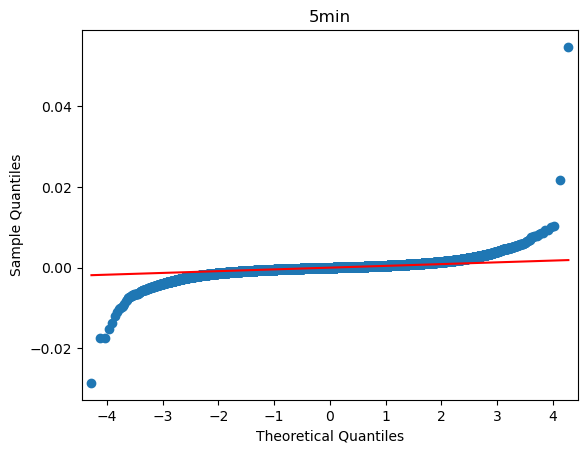

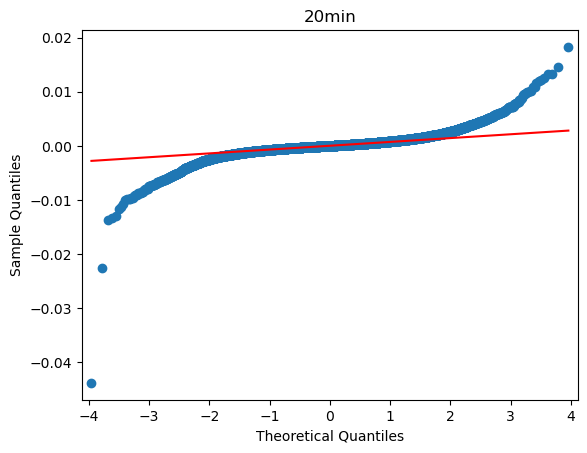

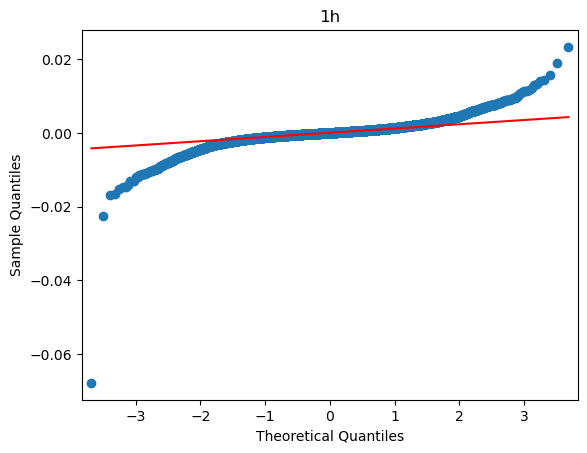

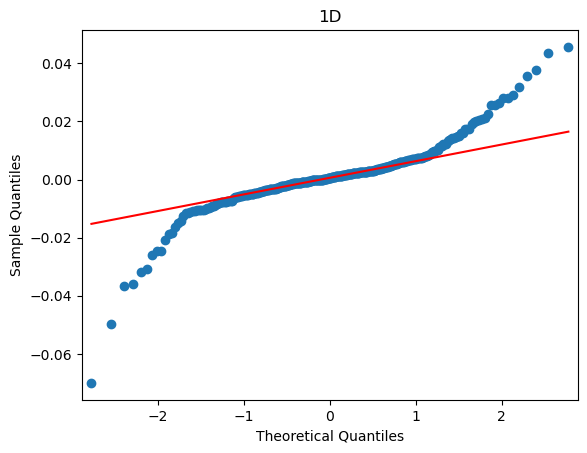

In [61]:
# get the qqplot of log returns to check its distribution agains a normal distribution
print(format.bold + "Nobitex Time Series" + format.reset)
for i in range(len(resampling_periods)):
    sm.qqplot(nobitex_resampled[i]['log_return'], line='q')
    plt.title(resampling_periods[i])
    plt.show()

Tabdeal Time Series


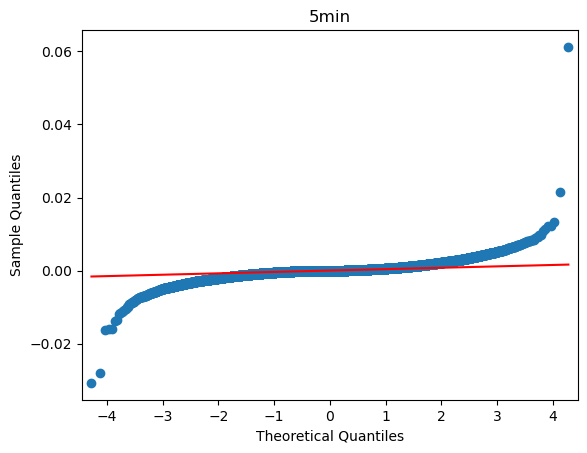

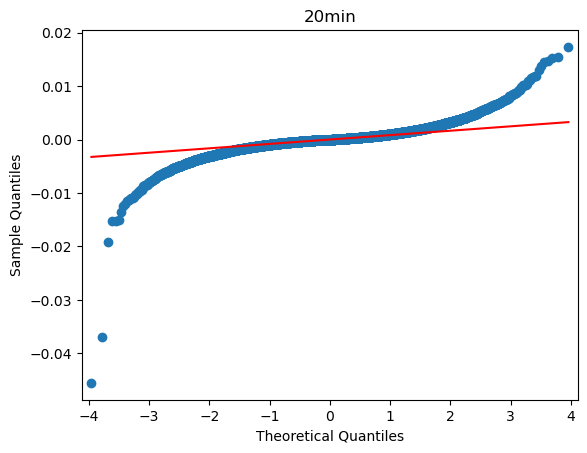

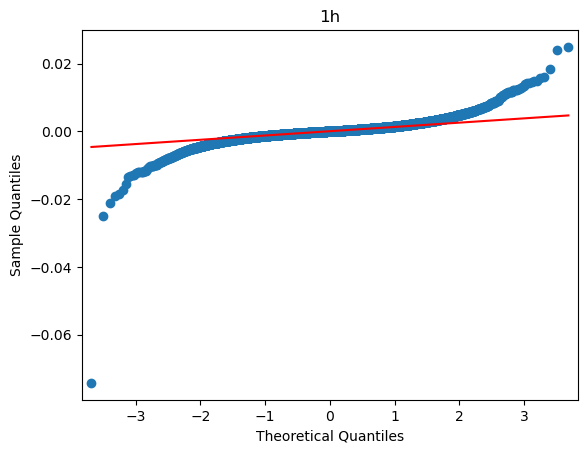

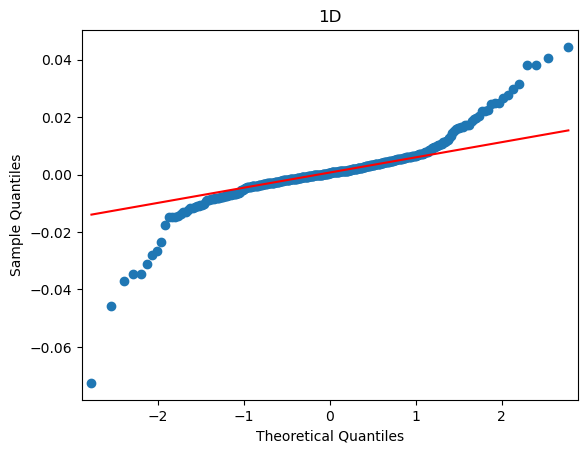

In [62]:
print(format.bold + "Tabdeal Time Series" + format.reset)
for i in range(len(resampling_periods)):
    sm.qqplot(tabdeal_resampled[i]['log_return'], line='q')
    plt.title(resampling_periods[i])
    plt.show()

Wallex Time Series


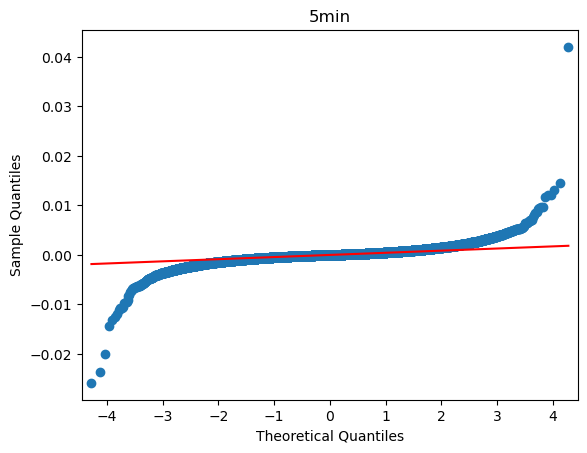

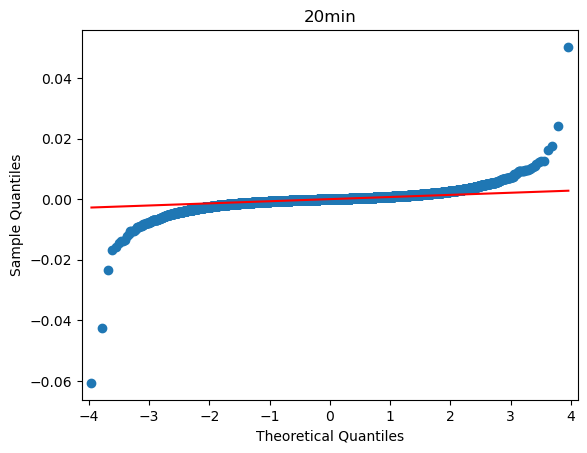

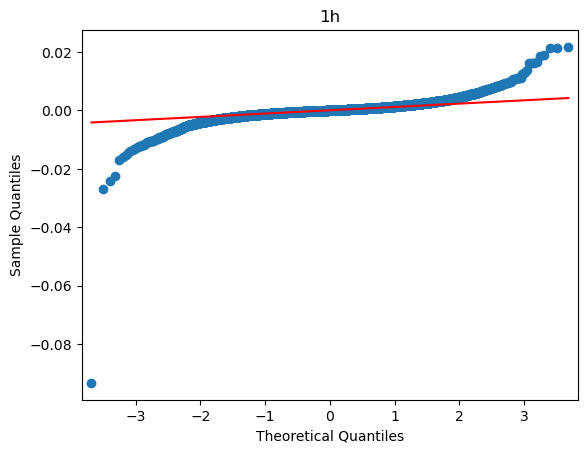

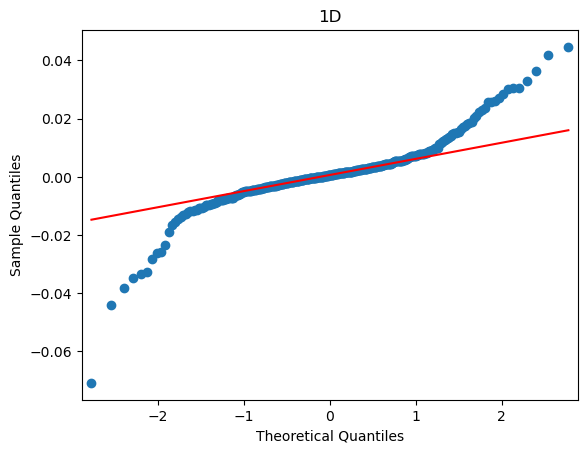

In [63]:
print(format.bold + "Wallex Time Series" + format.reset)
for i in range(len(resampling_periods)):
    sm.qqplot(wallex_resampled[i]['log_return'], line='q')
    plt.title(resampling_periods[i])
    plt.show()

<h3 style="color: #c83349;">5. Quantitative Normality Tests</h3>

In [64]:
# take the Shapiro-Wilk test for each time scale
stats_test = dict.fromkeys(resampling_periods)
for i in range(len(resampling_periods)):
    stats_test[resampling_periods[i]] = []
    stats_test[resampling_periods[i]].append(shapiro(nobitex_resampled[i]['log_return'])[1])
    stats_test[resampling_periods[i]].append(shapiro(tabdeal_resampled[i]['log_return'])[1])
    stats_test[resampling_periods[i]].append(shapiro(wallex_resampled[i]['log_return'])[1])

print(format.bold + "Shapiro-Wilk test results for Nobitex, Tabdeal, and Wallex respectively." + format.reset)
stats_test

Shapiro-Wilk test results for Nobitex, Tabdeal, and Wallex respectively.


/Users/sarina.jami/anaconda3/lib/python3.12/site-packages/scipy/stats/_axis_nan_policy.py:531: UserWarning:

scipy.stats.shapiro: For N > 5000, computed p-value may not be accurate. Current N is 105118.

/Users/sarina.jami/anaconda3/lib/python3.12/site-packages/scipy/stats/_axis_nan_policy.py:531: UserWarning:

scipy.stats.shapiro: For N > 5000, computed p-value may not be accurate. Current N is 26278.

/Users/sarina.jami/anaconda3/lib/python3.12/site-packages/scipy/stats/_axis_nan_policy.py:531: UserWarning:

scipy.stats.shapiro: For N > 5000, computed p-value may not be accurate. Current N is 8758.



{'5min': [2.3906560936310034e-132,
  6.104234969588622e-135,
  1.5578127415253937e-128],
 '20min': [5.750035311659742e-99,
  2.1820988340463838e-94,
  7.020635438883121e-108],
 '1h': [1.496828699660288e-75, 5.0847282155217244e-76, 3.664535885218439e-82],
 '1D': [5.723099596527334e-18, 1.1500282008664954e-18, 9.869634124715454e-18]}

<h3 style="color: #c83349;">6. Importance of Normality</h3>

<p>In <span style="font-weight:500;">financial analysis</span>, the assumption of normal distribution is foundational due to its mathematical convenience and widespread application. Assumption of normality helps in ways such as <i>Simplification of Risk Calculations</i>, <i>Predictability and Stability</i>, and <i>Analytical Tools</i>.</p>
<ul>
<li>
<p><b style="color: #3e4444;">Simplification of Risk Calculations:</b> Under the normalitiy assumption, Value at Risk (VaR) calculations become straight forward. Using the 68-95-99.7 rule, the probability of returns falling within a certain number of standard deviations can be easily computed. Also, the mean-variance framework for optimizing portfolios relies heavily on normality.</p>
</li>
<li>
<p><b style="color: #3e4444;">Predictability and Stability:</b> Since a normal distribution is symmetrical with no skewness, upside and downside risks are treated equally. Assumption of normality for log returns is also used with central limit theorem which assumes normality in aggregated returns over time.</p>
</li>
<li>
<p><b style="color: #3e4444;">Analytical Tools:</b> Many statistical and mathematical models assume normality.</p>
</li>
</ul>

<p style="font-weight:500; font-size:16px; text-decoration:underline;">Non-Normality in Financial Modeling:</p>
<ul>
<li>
<p><b style="color: #3e4444;">Underestimation of Tail Risk (Fat Tails):</b> The normal distribution underestimates the probability of extreme events (outliers). In real financial markets, fat tails imply a higher likelihood of large losses or gains.</p>
</li>
<li>
<p><b style="color: #3e4444;">Impact of Skewness:</b> Risk models assuming symmetry might fail to anticipate downside risks, resulting in poor hedging strategies.</p>
</li>
<li>
<p><b style="color: #3e4444;">Volatility Clustering:</b> Volatility is not constant - it tends to cluster. This behavior is not captured by models assuming independent, identically distributed returns.</p>
</li>
<li>
<p><b style="color: #3e4444;">Model Breakdown for Extreme Events:</b> Many financial models assume that returns within ±3 standard deviations cover almost all scenarios. In non-normal distributions, extreme movements occur more frequently.</p>
</li>
</ul>

<h2 style="color: #618685;">2.2 Autocorrelation and Stationarity Analysis</h2>

<h3 style="color: #c83349;">1. ACF and PACF Plots</h3>

<p><b>Autocorrelation Function:</b> Measures the correlation between a time series and its lagged values. It shows how past values influence current values. It helps identify <i>long-term dependencies</i> or <i>trends</i>.</p>
<p><b>Partial Autocorrelation Function:</b> Measures the correlation between a time series and its lagged values, removing the influence of intermediate lags. It identifies the direct effect of each lag which is useful for detecting <i>AR (Auto-Regressive) components</i> in a time series. AR models are foundational for understanding temporal dependencies in financial data, aiding in forecasting and decision-making.</p>

<p><b style="font-weight:500; font-size:16px; text-decoration:underline;">Analysis of Plots:</b></p>
<p style="font-weight:500;">ACF:</p>
<ul>
<li>
<p>Slow rate of decay into significant territory in the ACF plot shows the series likely has a <b style="color: #3e4444;">trend</b> and is <b style="color: #3e4444;">non-stationary</b>.</p>
</li>
<li>
<p>Significant spikes at regular intervals shows <b style="color: #3e4444;">seasonal patterns</b>.</p>
</li>
<li>
<p>If autocorrelation remains significant for many lags, it indicates <b style="color: #3e4444;">persistence</b> in the data.</p>
</li>
</ul>

<p style="font-weight:500;">PACF:</p>
<ul>
<li>
<p>A sharp cut off after a few lags indicates an <b style="color: #3e4444;">Auto-Regressive</b> model.</p>
</li>
<li>
<p>It shows the <b style="color: #3e4444;">direct effect</b> of each lag on the current value.</p>
</li>
<li>
<p>It assumes <b style="color: #3e4444;">stationarity</b>. Non-stationary data can yield misleading PACF results and should be differenced or transformed first.</p>
</li>
</ul>

<p><b style="font-weight:500; font-size:16px; text-decoration:underline;">Interpreting Below Plots:</b></p>
<p style="font-weight:500;">Price Series:</p>
<ul>
<li>
<p>The autocorrelations for all time scales slowly decays which show the price series are non-stationary. This suggests the series has a trend and indicates market inefficiency and predictability. It can help with trend trading strategies to generate abnormal profits.</p>
</li>
<li>
<p>We can observe that as the time frequency of data decreases, the autocorrelation plot decays faster compared to high frequency time series. This is because when we downsample the data, we loss the granularity in data and the variance between consecutive observations reduces, thus the short-term dependencies are diminished. Furthermore, we can observe that the ACF plot for 1-day time series stays significant for many lags which shows the long-term trend and persistency in the data.</p>
</li>
<li>
<p>The partial autocorrelations at all lags can be computed by fitting a succession of autoregressive models with increasing numbers of lags. Thus, by mere inspection of PACF we can determine how many AR terms we need to use to explain the autocorrelation pattern in a time series.</p>
</li>
</ul>

<p style="font-weight:500;">Log Returns:</p>
<ul>
<li>
<p>Since the ACF is only 1 at lag 0 and very low (nearly zero) for other lags, it indicated the current value of the time series has little to no linear temporal dependency on past values.</p>
</li>
<li>
<p>The lack of significant autocorrelation at any lag suggests that the series is stationary which suggests differencing is unnecessary.</p>
</li>
</ul>

<p style="font-weight:500;">Volatility:</p>
<ul>
<li>
<p>The slow decay in the ACF of volatility indicated the volatility clustering. It also shows long memory behavior of volatility series, implying that volatility shocks have long-lasting effects on the market.</p>
</li>
<li>
<p>Persistence in volatility implies that it can be forecasted with reasonable accuracy, unlike returns themselves, which are harder to predict.</p>
</li>
<li>
<p>Persistent volatility clustering means that periods of market instability may last longer, requiring dynamic risk measures like time-varying Value-at-Risk (VaR) or Conditional VaR.</p>
</li>
<li>
<p>The PACF for all time scales shows we can model the volatility with order 1.</p>
</li>
</ul>

In [65]:
# plot acf and pacf using plotly interactive features
def create_corr_plot(series, title, plot_pacf=False):
    # get the correlation coeficients and the confidence intervals
    corr_array = pacf(series.dropna(), alpha=0.05) if plot_pacf else acf(series.dropna(), alpha=0.05)
    lower_y = corr_array[1][:,0] - corr_array[0]
    upper_y = corr_array[1][:,1] - corr_array[0]

    # fig = go.Figure()
    # [fig.add_scatter(x=(x,x), y=(0,corr_array[0][x]), mode='lines',line_color='#3f3f3f') 
    #  for x in range(len(corr_array[0]))]
    # fig.add_scatter(x=np.arange(len(corr_array[0])), y=corr_array[0], mode='markers', marker_color='#1f77b4',
    #                marker_size=12)
    # fig.add_scatter(x=np.arange(len(corr_array[0])), y=upper_y, mode='lines', line_color='rgba(255,255,255,0)')
    # fig.add_scatter(x=np.arange(len(corr_array[0])), y=lower_y, mode='lines',fillcolor='rgba(32, 146, 230,0.3)',
    #         fill='tonexty', line_color='rgba(255,255,255,0)')
    # fig.update_traces(showlegend=False)
    # fig.update_xaxes(range=[-1,len(corr_array[0])])
    # fig.update_yaxes(zerolinecolor='#000000')
    
    # plot_title='Partial Autocorrelation: ' + title if plot_pacf else 'Autocorrelation: ' + title
    # fig.update_layout(title=plot_title, height=500)
    # fig.show()

<p style="font-size:18px; font-weight:500">ACF and PACF for Nobitex Price Series:</p>

In [66]:
# plot acf and pacf for price series of all the time scales
for i in range(len(resampling_periods)):
    create_corr_plot(nobitex_resampled[i]['vwap'], resampling_periods[i])

for i in range(len(resampling_periods)):
    create_corr_plot(nobitex_resampled[i]['vwap'], resampling_periods[i], plot_pacf=True)

<p style="font-size:18px; font-weight:500">ACF and PACF for Tabdeal Price Series:</p>

In [67]:
# plot acf and pacf for price series of all the time scales
for i in range(len(resampling_periods)):
    create_corr_plot(tabdeal_resampled[i]['vwap'], resampling_periods[i])

for i in range(len(resampling_periods)):
    create_corr_plot(tabdeal_resampled[i]['vwap'], resampling_periods[i], plot_pacf=True)

<p style="font-size:18px; font-weight:500">ACF and PACF for Wallex Price Series:</p>

In [68]:
# plot acf and pacf for price series of all the time scales
for i in range(len(resampling_periods)):
    create_corr_plot(wallex_resampled[i]['vwap'], resampling_periods[i])

for i in range(len(resampling_periods)):
    create_corr_plot(wallex_resampled[i]['vwap'], resampling_periods[i], plot_pacf=True)

<p style="font-size:18px; font-weight:500">ACF and PACF for Nobitex Log Returns:</p>

In [69]:
# plot acf and pacf for log returns of all the time scales
for i in range(len(resampling_periods)):
    create_corr_plot(nobitex_resampled[i]['log_return'], resampling_periods[i])

for i in range(len(resampling_periods)):
    create_corr_plot(nobitex_resampled[i]['log_return'], resampling_periods[i], plot_pacf=True)

<p style="font-size:18px; font-weight:500">ACF and PACF for Tabdeal Log Returns:</p>

In [70]:
# plot acf and pacf for log returns of all the time scales
for i in range(len(resampling_periods)):
    create_corr_plot(tabdeal_resampled[i]['log_return'], resampling_periods[i])

for i in range(len(resampling_periods)):
    create_corr_plot(tabdeal_resampled[i]['log_return'], resampling_periods[i], plot_pacf=True)

<p style="font-size:18px; font-weight:500">ACF and PACF for Wallex Log Returns:</p>

In [71]:
# plot acf and pacf for log returns of all the time scales
for i in range(len(resampling_periods)):
    create_corr_plot(wallex_resampled[i]['log_return'], resampling_periods[i])

for i in range(len(resampling_periods)):
    create_corr_plot(wallex_resampled[i]['log_return'], resampling_periods[i], plot_pacf=True)

<p style="font-size:18px; font-weight:500">ACF and PACF for Nobitex Volatility:</p>

In [72]:
# plot acf and pacf for log returns of all the time scales
for i in range(len(resampling_periods)):
    create_corr_plot(nobitex_resampled[i]['EWMA_volatility'], resampling_periods[i])

for i in range(len(resampling_periods)):
    create_corr_plot(nobitex_resampled[i]['EWMA_volatility'], resampling_periods[i], plot_pacf=True)

<p style="font-size:18px; font-weight:500">ACF and PACF for tabdeal Volatility:</p>

In [73]:
# plot acf and pacf for log returns of all the time scales
for i in range(len(resampling_periods)):
    create_corr_plot(tabdeal_resampled[i]['EWMA_volatility'], resampling_periods[i])

for i in range(len(resampling_periods)):
    create_corr_plot(tabdeal_resampled[i]['EWMA_volatility'], resampling_periods[i], plot_pacf=True)

<p style="font-size:18px; font-weight:500">ACF and PACF for wallex Volatility:</p>

In [74]:
# plot acf and pacf for log returns of all the time scales
for i in range(len(resampling_periods)):
    create_corr_plot(wallex_resampled[i]['EWMA_volatility'], resampling_periods[i])

for i in range(len(resampling_periods)):
    create_corr_plot(wallex_resampled[i]['EWMA_volatility'], resampling_periods[i], plot_pacf=True)

<h3 style="color: #c83349;">2. Stationarity Testing</h3>

<p>A <b style="color: #3e4444;">stationary series</b> is one whose statistical properties such as mean, variance, covariance, and standard deviation do not vary with time.</p>
<p>Stationary series is easier for <b style="color: #3e4444;">statistical models</b> to predict effectively and precisely.</p>
<p>The Augmented Dickey-Fuller test is a type of statistical test called a <b style="color: #3e4444;">unit root</b> test. A unit root process determines the stochasticity of a model which determines whether differencing is required.</p>
<p>We choose a <b style="color: #3e4444;">significant level of 0.01</b>, Therefore, a p-value less than 0.01 and test statistic less than critical value (1%) reject null hypothesis which means the time series may be stationary.</p> 
<p>Furthermore, we should consider that ADF test has a downside of farily high Type 1 error rate.</p>

In [75]:
# get ADF test from a time series
def get_adf(series):
    adftest = adfuller(series)
    # create a series including ADF test result
    adf_output = pd.Series(adftest[0:4], index=['Test Statistic','p-value','#Lags Used','Number of Observations Used'])
    for key, value in adftest[4].items():
        adf_output['Critical Value (%s)' %key] = value

    return adf_output

# check the validity of the null hypothesis
def validate_stationarity(test_output):
    """ ADF Test:
        the null hypothesis assumes the data is non-stationary. If test statistic is lower than critical value for alpha = 0.01 
        and p value is less than 0.01, then we can reject the null hypothesis which suggests the data is stationary, and the test
        result is statistically significant. 
    """

    if (test_output.loc['p-value'] < 0.01) and (test_output.loc['Test Statistic'] < test_output.loc['Critical Value (1%)']):
        print(format.green + 'Stationary' + format.reset)
    else:
        print(format.red + 'Insufficient evidence to reject non-stationarity' + format.reset)

# test the stationarity of the time series using ADF test
def test_stationarity(series, features):
    for i in range(len(features)):
        print(format.bold + features[i] + format.reset)
        
        # get ADF test
        adf_output = get_adf(series.loc[:, features[i]])
        
        # print test result
        print(adf_output)
        validate_stationarity(adf_output)

In [76]:
# get the test over all time scales of Nobitex time series
for i in range(len(resampling_periods)):
    print(format.bold + f'Stationarity Test for {resampling_periods[i]} Nobitex Time Series:' + format.reset)
    test_stationarity(nobitex_resampled[i], ['vwap', 'log_return', 'EWMA_volatility'])

Stationarity Test for 5min Nobitex Time Series:
vwap
Test Statistic                     -2.894443
p-value                             0.045998
#Lags Used                         69.000000
Number of Observations Used    105048.000000
Critical Value (1%)                -3.430412
Critical Value (5%)                -2.861568
Critical Value (10%)               -2.566785
dtype: float64
Insufficient evidence to reject non-stationarity
log_return
Test Statistic                    -39.067389
p-value                             0.000000
#Lags Used                         68.000000
Number of Observations Used    105049.000000
Critical Value (1%)                -3.430412
Critical Value (5%)                -2.861568
Critical Value (10%)               -2.566785
dtype: float64
Stationary
EWMA_volatility
Test Statistic                    -20.393211
p-value                             0.000000
#Lags Used                         68.000000
Number of Observations Used    105049.000000
Critical Value (1%) 

In [77]:
# get the test over all time scales of Tabdeal time series 
for i in range(len(resampling_periods)):
    print(format.bold + f'Stationarity Test for {resampling_periods[i]} Tabdeal Time Series:' + format.reset)
    test_stationarity(tabdeal_resampled[i], ['vwap', 'log_return', 'EWMA_volatility'])

Stationarity Test for 5min Tabdeal Time Series:
vwap
Test Statistic                     -2.839546
p-value                             0.052843
#Lags Used                         63.000000
Number of Observations Used    105054.000000
Critical Value (1%)                -3.430412
Critical Value (5%)                -2.861568
Critical Value (10%)               -2.566785
dtype: float64
Insufficient evidence to reject non-stationarity
log_return
Test Statistic                    -50.852489
p-value                             0.000000
#Lags Used                         46.000000
Number of Observations Used    105071.000000
Critical Value (1%)                -3.430412
Critical Value (5%)                -2.861568
Critical Value (10%)               -2.566785
dtype: float64
Stationary
EWMA_volatility
Test Statistic                    -19.020969
p-value                             0.000000
#Lags Used                         68.000000
Number of Observations Used    105049.000000
Critical Value (1%) 

In [78]:
# get the test over all time scales of Wallex time series
for i in range(len(resampling_periods)):
    print(format.bold + f'Stationarity Test for {resampling_periods[i]} Wallex Time Series:' + format.reset)
    test_stationarity(wallex_resampled[i], ['vwap', 'log_return', 'EWMA_volatility'])

Stationarity Test for 5min Wallex Time Series:
vwap
Test Statistic                     -2.809795
p-value                             0.056888
#Lags Used                         69.000000
Number of Observations Used    105048.000000
Critical Value (1%)                -3.430412
Critical Value (5%)                -2.861568
Critical Value (10%)               -2.566785
dtype: float64
Insufficient evidence to reject non-stationarity
log_return
Test Statistic                    -39.267662
p-value                             0.000000
#Lags Used                         68.000000
Number of Observations Used    105049.000000
Critical Value (1%)                -3.430412
Critical Value (5%)                -2.861568
Critical Value (10%)               -2.566785
dtype: float64
Stationary
EWMA_volatility
Test Statistic                    -19.850783
p-value                             0.000000
#Lags Used                         68.000000
Number of Observations Used    105049.000000
Critical Value (1%)  

<h3 style="color: #c83349;">3. Interplay of Non-Stationarity and Autocorrelation</h3>

<p style="font-weight:500;">Stationarity Test and Autocorrelation:</p>
<ul>
<li>
<p>Non-stationary series often show persistent autocorrelation over many lags, reflecting trends or long memory.</p>
</li>
<li>
<p>Stationary series may exhibit short-term autocorrelation, useful for predictive modeling.</p>
</li>
</ul>
The ADF test supports the result of ACF and PACF for close prices which indicate that they are <i>non-stationary</i> and log returns that are <i>stationary.</i> I expect volatility to be non-stationary according to ACF plots, but ADF test result shows otherwise. This may be due to type 1 error in ADF.</p>
<p style="font-weight:500;">Non-stationarity in Financial Time Series:</p>
<ul>
<li>
<p>Financial series are typically non-stationary due to trends, seasonality, or evolving market conditions.</p>
</li>
<li>
<p>Non-stationary series are unsuitable for standard statistical models that assume stationarity.</p>
</li>
<li>
<p>Predictions based on raw non-stationary data may fail to generalize due to the absence of a stable structure.</p>
</li>
</ul>
<p style="font-weight:500;">Implications for Predictive Modeling and Strategy Development:</p>
<ul>
<li>
<p>Models trained on non-stationary data often fail to generalize due to regime shifts or changing dynamics.</p>
</li>
<li>
<p>Enable the use of autoregressive models by converting a non-stationary series into a stationary one by removing trends.</p>
</li>
<li>
<p>Short-term autocorrelation can signal predictable price movements, informing momentum or mean-reversion strategies.</p>
</li>
<li>
<p>Use of trend-following strategies which capitalize on persistent trends in non-stationary data.</p>
</li>
</ul>

<h2 style="color: #618685;">2.3 Inter-Market Analysis</h2>

<h3 style="color: #c83349;">1. Synchronous Correlations</h3>

In [79]:
# Compute lagged correlations between two different time series
def compute_lagged_corr(df1, 
                        df2, 
                        rolling_window, # rolling window of one month
                        # arguments for print statement
                        df1_name,
                        df2_name,
                        time_scale
                        ):

    df2_shifted = df2.shift(1)
    df1_shifted = df1.shift(1)

    # take the rolling window cross correlation
    corr_df2_lagged = df1['log_return'].rolling(window=rolling_window).corr(df2_shifted['log_return'])
    corr_df1_lagged = df2['log_return'].rolling(window=rolling_window).corr(df1_shifted['log_return'])

    # plot the correlation
    # fig = go.Figure()
    # fig.add_trace(go.Scatter(x=corr_df2_lagged.index.astype(dtype=str), 
    #                         y=corr_df2_lagged, name=f"{df2_name} leads"))
    # fig.add_trace(go.Scatter(x=corr_df1_lagged.index.astype(dtype=str), 
    #                         y=corr_df1_lagged, name=f"{df1_name} leads"))
    # fig.update_layout(title_text=f"Lagged correlations for {time_scale} {df1_name} and {df2_name}",
    #                   height=500,
    #                   showlegend=True)
    # fig.show()

In [80]:
# Compute synchronous correlations between two different time series
def compute_synch_corr(df1, 
                      df2, 
                      rolling_window, # rolling window of one month
                      print_statement
                     ):
    
    # take the rolling window cross correlation
    sync_corr = df1['log_return'].rolling(window=rolling_window).corr(df2['log_return'])

    # plot the correlation
    # fig = go.Figure()
    # fig.add_trace(go.Scatter(x=sync_corr.index.astype(dtype=str), 
    #                         y=sync_corr,
    #                         marker_color='indianred'))
    # fig.update_layout(title_text="Synchronous correlations for " + print_statement,
    #                   height=500,
    #                   showlegend=False)
    # fig.show()

# rolling window of one month for each time scale respectively
window = [12*24*30, 3*24*30, 24*30, 30]

In [81]:
# correlation between nobitex and tabdeal
for i in range(len(resampling_periods)):
    compute_synch_corr(nobitex_resampled[i], tabdeal_resampled[i], window[i], f'{resampling_periods[i]} data (nobitex and tabdeal)')

In [82]:
# correlation between nobitex and wallex
for i in range(len(resampling_periods)):
    compute_synch_corr(nobitex_resampled[i], wallex_resampled[i], window[i], f'{resampling_periods[i]} data (nobitex and wallex)')

In [83]:
# correlation between tabdeal and wallex
for i in range(len(resampling_periods)):
    compute_synch_corr(tabdeal_resampled[i], wallex_resampled[i], window[i], f'{resampling_periods[i]} data (tabdeal and wallex)')

<h3 style="color: #c83349;">2. Lagged Correlations</h3>

In [84]:
# Compute pairwise lagged correlations between nobitex and tabdeal
for i in range(len(resampling_periods)):
    compute_lagged_corr(nobitex_resampled[i], tabdeal_resampled[i], window[i], 'nobitex', 'tabdeal', resampling_periods[i])

In [85]:
# Compute pairwise lagged correlations between nobitex and wallex
for i in range(len(resampling_periods)):
    compute_lagged_corr(nobitex_resampled[i], wallex_resampled[i], window[i], 'nobitex', 'wallex', resampling_periods[i])

In [86]:
# Compute pairwise lagged correlations between tabdeal and wallex
for i in range(len(resampling_periods)):
    compute_lagged_corr(tabdeal_resampled[i], wallex_resampled[i], window[i], 'tabdeal', 'wallex', resampling_periods[i])

<h3 style="color: #c83349;">3. Application to Strategy</h3>

<p>We observe that the synchronous correlations increase as we move to lower frequencies in time series data. This happens because lower-frequency data tends to smooth out noise and short-term fluctuations, highlighting the underlying long-term relationships between the series. High-frequency data, on the other hand, can exhibit more noise, leading to lower observed correlations.</p>
<p>For the lagged correlations, as the frequency decreases, the two time series show higher correlations as expected since the fluctuations are smoothed out in the lower-frequencey data. We observe that for all pairs of time series, both markets have either lag or lead relationships in different months.</p>
<p style="font-weight:500;">Synchronous Correlations:</p>
<ul>
<li>
<p>The high variability in synchronous correlations suggest that the relationship between each pair is dynamic and changes frequently, likely due to market conditions, varying liquidity, or external events.</p>
</li>
<li>
<p>Periods of high positive correlation suggest that both time series are moving in the same direction, reflecting synchronous market behavior which can be utilized in arbitrage trading.</p>
</li>
<li>
<p>External market shocks, news, or liquidity shifts could cause correlations to spike or drop sharply at specific points, highlighting periods of market inefficiency or structural changes.</p>
</li>
<li>
<p>When synchronous correlation is high, monitor price spreads between the two markets. If the spread deviates significantly from the mean, initiate trades to buy in the lower-priced market and sell in the higher-priced one.</p>
</li>
</ul>

<p style="font-weight:500;">Lagged Correlations:</p>
<ul>
<li>
<p>Positive correlations imply periods where a market leads the lagged market in the same direction. This indicates potential short-term predictive power.</p>
</li>
<li>
<p>Negative correlations suggest an inverse relationship.</p>
</li>
<li>
<p>In efficient markets, you would expect consistent relationships due to rapid information dissemination. In this case, the unstable lagged correlation suggests that information flow between the two markets is not uniform thus the market is inefficient.</p>
</li>
<li>
<p>For <strong>Nobitex</strong> and <strong>Tabdeal</strong> markets, we can observe that Tabdeal consistenly leads Nobitex market for 5min, 20min, and 1h time scales. But, for 1D time scale, we observe that the two markets compete and they indicate both lag and lead relationships.</p>
</li>
<li>
<p>For <strong>Wallex</strong> and <strong>Nobitex</strong> markets, we can observe that Wallex mostly leads Nobitex for 5min, 20min, and 1h time scales. But, for 1D time scale, the two markets compete and they indicate both lag and lead relationships.</p>
</li>
<li>
<p>For <strong>Wallex</strong> and <strong>Tabdeal</strong> markets, we can observe that the two markets consistently compete and either lead or lag one another in different months of the year.
</p>
</li>
</ul>

<p style="font-weight:500;">Implications:</p>
<ul>
<li>
<p>Since Tabdeal and Wallex mostly lead Nobitex market for 5min, 20min, and 1h time scales, we can use these two markets to predict Nobitex exchange rate.</p>
</li>
<li>
<p>Divergences in synchronous correlations suggest opportunities for mean-reversion strategies, where extreme movements in one market predict corrections in the other market.</p>
</li>
<li>
<p>Unstable correlations suggest markets are less predictable, requiring more conservative or diversified approaches.</p>
</li>
<li>
<p>Movements in the leading market can be used as a signal to anticipate the future movements in the lagging market. This opens up opportunities to design trading strategies based on the observed lead-lag relationship.</p>
</li>
<li>
<p>Extreme deviations (e.g. sharp dips or spikes in correlation) could signal market events that create temporary inefficiencies, providing arbitrage opportunities or cautionary signals for risk management.</p>
</li>
<li>
<p>The variability in the correlations can reflect the volatility in the market. Periods of high volatility may amplify these relationships, making them more exploitable for short-term strategies.</p>
</li>
</ul>

<h1 style="color: #4040a1;">Task 3: Cointegration Analysis</h1>

<h2 style="color: #618685;">1. Cointegration Testing Methodology</h2>

<p><b>Cointegration tests</b> identify scenarios where two or more non-stationary time series are integrated together in a way that they cannot deviate from equilibrium in the long term. The tests are used to identify the degree of sensitivity of two variables to the same average price over a specified period of time.</p>
<p>Before the introduction of cointegration tests, economists relied on linear regressions to find the relationship between several time series processes. However, linear regression in analyzing time series may produce a <b>spurious correlation</b>. A spurious correlation occurs when two or more associated variables are deemed causally related due to either a coincidence or an unknown third factor. A possible result is a misleading statistical relationship between several time series variables.</p>

<p style="font-weight:500; text-decoration:underline;">Steps for cointegration test using <i>Engle-Granger Two-Step Method:</i></p>
<p>It requires the data to be <b>non-stationary</b> and have <b>unit roots</b>. The close prices have unit roots according to ADF test results.</p>
<ol>
<li>
<p>Check Non-Stationarity of Both Series</p>
</li>
<li>
<p>Regress One Series on the Other</p>
</li>
<li>
<p>Test the Residuals for Stationarity (ADF Test)</p>
</li>
<li>
<p>Validate the Cointegration (Plot Residuals)</p>
</li>
</ol>

<p>As we can see below, the cointegration test for all the pairwise time series indicate that they form a long-term equilibrium relationship. We can further examine the validity of this results by Error Correction Modeling since some results may be spurious.</p>

In [87]:
# define cointegration function
def test_cointegration(y_series, # the time series as the dependent variable
                       x_series # the time series as the independent variable
                      ):
    """ The long-term equilibrium relationship is represented as:
            Y = β0 + β1X + ϵ
        Y: Non-stationary time series (dependent variable)
        X: Non-stationary time series (independent variable)
        ϵ: The error term representing the deviation from equilibrium

        If ϵ is stationary (i.e., mean-reverting), Y and X are said to be cointegrated.
    """
    # set x and y for regression model
    x = np.asarray(x_series['vwap'])
    y = np.asarray(y_series['vwap'])
    # add a constant column for OLS model
    X = sm.add_constant(x)
    
    # fit the model
    model = sm.OLS(y, X).fit()
    
    # get the parameters of the fitted line
    alpha = model.params[0] # intercept
    beta = model.params[1] # slope
    print(f'y = {alpha} + {beta}*x')

    # get the residuals
    residuals = y - (alpha + beta * x)
    residuals_series = pd.Series(residuals, index=x_series.index)

    # conduct ADF test on residuals to check stationarity
    adf_result = adfuller(residuals_series)

    print(f"Test Statistic: {adf_result[0]}")
    print(f"p-value: {adf_result[1]}")
    print(f"Critical Values: {adf_result[4]}")

    # check if residuals are stationary
    if (adf_result[0] < adf_result[4]['1%']) and (adf_result[1] < 0.01):
        print(format.green + 'Stationary' + format.reset)

    return residuals_series

In [88]:
# test cointegration and store residuals for each pair of time series
resid_nobitex_tabdeal = []
resid_nobitex_wallex = []
resid_wallex_tabdeal = []
for i in range(len(resampling_periods)):
    # Nobitex and Tabdeal
    print(format.bold + f'Cointegration Test for {resampling_periods[i]} Nobitex and Tabdeal Series' + format.reset)
    resid_nobitex_tabdeal.append(test_cointegration(tabdeal_resampled[i], nobitex_resampled[i]))
    # Nobitex and Wallex
    print(format.bold + f'Cointegration Test for {resampling_periods[i]} Nobitex and Wallex Series' + format.reset)
    resid_nobitex_wallex.append(test_cointegration(wallex_resampled[i], nobitex_resampled[i]))
    # Wallex and Tabdeal
    print(format.bold + f'Cointegration Test for {resampling_periods[i]} Wallex and Tabdeal Series' + format.reset)
    resid_wallex_tabdeal.append(test_cointegration(tabdeal_resampled[i], wallex_resampled[i]))

Cointegration Test for 5min Nobitex and Tabdeal Series
y = 186.53633867546583 + 0.9979956177868345*x
Test Statistic: -12.969204125204437
p-value: 3.1067887534270998e-24
Critical Values: {'1%': -3.430412251518808, '5%': -2.8615675142105936, '10%': -2.5667846448489744}
Stationary
Cointegration Test for 5min Nobitex and Wallex Series
y = 127.72144545136597 + 0.9983816455001485*x
Test Statistic: -16.848793439774745
p-value: 1.1229579847823172e-29
Critical Values: {'1%': -3.4304122509262043, '5%': -2.8615675139486747, '10%': -2.5667846447095637}
Stationary
Cointegration Test for 5min Wallex and Tabdeal Series
y = 74.21317975375892 + 0.9993011849854306*x
Test Statistic: -18.994889858273545
p-value: 0.0
Critical Values: {'1%': -3.430412251518808, '5%': -2.8615675142105936, '10%': -2.5667846448489744}
Stationary
Cointegration Test for 20min Nobitex and Tabdeal Series
y = 194.246605031918 + 0.9978523317188593*x
Test Statistic: -9.37848717989017
p-value: 7.061131687117367e-16
Critical Values: {'

<h2 style="color: #618685;">2. Dynamic Analysis of Cointegration Parameters</h2>

In [89]:
# separate a time series into monthly segments
def separate_by_month(series):
    # create a dictionary with each key containing the data of one month
    monthly_segments = {month: group for month, group in series.resample('ME')}
    # get the timestamp for each month
    keys = list(monthly_segments.keys())
    # create a list of monthly segments as time series
    monthly_series = []
    for i in range(len(keys)):
        monthly_series.append(monthly_segments[pd.Timestamp(keys[i])])
    return monthly_series, keys
    
def test_dynamic_cointegration(y_series, x_series):
    # get monthly segments of both series
    Y_months_segments, keys = separate_by_month(y_series['vwap'])
    X_months_segments, _ = separate_by_month(x_series['vwap'])
    
    # define a dataframe to store results of each month for comparison
    rows = ['alpha', 'beta', 'test statistic', 'p-value']
    cols = [key.month_name()[:3] for key in keys]
    results = pd.DataFrame(index=rows, columns=cols)
    
    # perform cointegration test on each segment separately
    resids = [] # create a list of residuals for later use in ECM
    for i in range(len(Y_months_segments)):
        # fit the model
        y = np.asarray(Y_months_segments[i])
        x = np.asarray(X_months_segments[i])
        X = sm.add_constant(x)
        model = sm.OLS(y, X).fit()
        
        # get the line parameters
        alpha = model.params[0] # intercept
        beta = model.params[1] # slope
        
        # get the residuals
        residuals = y - (alpha + beta * x)
        residuals_series = pd.Series(residuals, index=X_months_segments[i].index)
        resids.append(residuals_series)
        
        # conduct ADF test on residuals to check stationarity
        adf_result = adfuller(residuals_series)

        # check if residuals are stationary
        print(f'Residuals on {cols[i]}:') 
        if (adf_result[0] < adf_result[4]['1%']) and (adf_result[1] < 0.01):
            print(format.green + 'Stationary' + format.reset)
        else:
            print(format.red + 'Insufficient evidence to reject non-stationarity.' + format.reset)
        
        # store values in the dataframe
        results.loc['alpha', cols[i]] = alpha
        results.loc['beta', cols[i]] = beta
        results.loc['test statistic', cols[i]] = adf_result[0]
        results.loc['p-value', cols[i]] = adf_result[1]

    return results, resids

In [90]:
# conduct dynamic cointegration on nobitex and tabdeal time series
monthly_resid_nobitex_tabdeal = []
monthly_resid_nobitex_wallex = []
monthly_resid_wallex_tabdeal = []
result_nobitex_tabdeal = []
result_nobitex_wallex = []
result_wallex_tabdeal = []
for i in range(len(resampling_periods)):
    # monthly cointegration test for Nobitex and Tabdeal
    print(format.bold + f'nobitex and tabdeal {resampling_periods[i]} data' + format.reset)
    result, resids = test_dynamic_cointegration(nobitex_resampled[i], tabdeal_resampled[i])
    monthly_resid_nobitex_tabdeal.append(resids)
    result_nobitex_tabdeal.append(result)

    # monthly cointegration test for Nobitex and Wallex
    print(format.bold + f'nobitex and wallex {resampling_periods[i]} data' + format.reset)
    result, resids = test_dynamic_cointegration(nobitex_resampled[i], wallex_resampled[i])
    monthly_resid_nobitex_wallex.append(resids)
    result_nobitex_wallex.append(result)

    # monthly cointegration test for Wallex and Tabdeal
    print(format.bold + f'wallex and tabdeal {resampling_periods[i]} data' + format.reset)
    result, resids = test_dynamic_cointegration(wallex_resampled[i], tabdeal_resampled[i])
    monthly_resid_wallex_tabdeal.append(resids)
    result_wallex_tabdeal.append(result)

nobitex and tabdeal 5min data
Residuals on Dec:
Stationary
Residuals on Jan:
Stationary
Residuals on Feb:
Stationary
Residuals on Mar:
Stationary
Residuals on Apr:
Stationary
Residuals on May:
Stationary
Residuals on Jun:
Stationary
Residuals on Jul:
Stationary
Residuals on Aug:
Stationary
Residuals on Sep:
Stationary
Residuals on Oct:
Stationary
Residuals on Nov:
Stationary
nobitex and wallex 5min data
Residuals on Dec:
Stationary
Residuals on Jan:
Stationary
Residuals on Feb:
Stationary
Residuals on Mar:
Stationary
Residuals on Apr:
Stationary
Residuals on May:
Stationary
Residuals on Jun:
Stationary
Residuals on Jul:
Stationary
Residuals on Aug:
Stationary
Residuals on Sep:
Stationary
Residuals on Oct:
Stationary
Residuals on Nov:
Stationary
wallex and tabdeal 5min data
Residuals on Dec:
Stationary
Residuals on Jan:
Stationary
Residuals on Feb:
Stationary
Residuals on Mar:
Stationary
Residuals on Apr:
Stationary
Residuals on May:
Stationary
Residuals on Jun:
Stationary
Residuals on 

In [91]:
# plot regression parameters (alpha and beta) and test statistics for comparison purposes
def plot_params(time_scale_idx, param_name):
    fig = go.Figure()
    fig.add_trace(go.Scatter(x=result_nobitex_tabdeal[time_scale_idx].columns.astype(dtype=str),
                             y=result_nobitex_tabdeal[time_scale_idx].loc[param_name],
                             name='Nob vs. Tab'))
    fig.add_trace(go.Scatter(x=result_nobitex_wallex[time_scale_idx].columns.astype(dtype=str),
                             y=result_nobitex_wallex[time_scale_idx].loc[param_name],
                             name='Nob vs. Wal'))
    fig.add_trace(go.Scatter(x=result_wallex_tabdeal[time_scale_idx].columns.astype(dtype=str),
                             y=result_wallex_tabdeal[time_scale_idx].loc[param_name],
                             name='Wal vs. Tab'))
    fig.update_layout(title=f'Comparison of {param_name} values for {resampling_periods[time_scale_idx]} time series')
    fig.update_traces(showlegend=True)
    fig.show()

In [92]:
# for i in range(len(resampling_periods)):
#     for param in ['alpha', 'beta', 'test statistic']:
#         plot_params(i, param)

<p style="font-size: 18px"><b>Interpretation:</b></p>
<ul>
<li><p><b>Cointegration for an entire year:</b> It indicates that the time series maintain a long-term equilibrium relationship despite short-term fluctuations. It suggests that each pair of markets are closely connected, and price deviations between the two markets are temporary, and they tend to revert to a stable equilibrium over time.</p>
</li>
<li><p><b>Cointegration for monthly segments:</b> For higher time scales (1-hour, 1-day), cointegration is observed only in a few months, whereas lower time scales (5-min, 20-min) consistently show cointegration. This indicates that at higher resolutions (5-min, 20-min), arbitrage mechanisms act quickly to maintain equilibrium, leading to consistent cointegration. Market inefficiencies are smaller and resolved faster. Short-term cointegration may reflect the activities of algorithmic and high-frequency traders, who actively exploit pricing discrepancies, keeping markets closely aligned. On larger time scales, the markets may be influenced by macroeconomic events, policy changes, or differing liquidity conditions. These factors might disrupt the equilibrium temporarily, leading to fewer months of observed cointegration. At 1 hour and 1 day time scales, deviations take longer to resolve. Some months may not provide enough time for the price series to revert to equilibrium. Furthermore, the loss of cointegration in some months for 1 hour and 1 day time scales may also point to structural changes in one or both markets, such as varying trading volumes, shifts in market participants, or regulatory interventions.</p>
</li>
</ul>

<p style="font-size: 16px"><b>Interpretation of changes in regression parameters and test statistic:</b></p>
<ul>
<li><p><b>alpha:</b> The wide range of α values suggests that the baseline relationship shifts significantly over time. This can be caused by changes in market structure, such as liquidity, trading volumes, or participant behavior. Dynamic baseline adjustments highlight the need for time-dependent modeling to capture shifts in equilibrium.</p></li>
<li><p><b>beta:</b> Across months, β stays close to 1, with minor deviations. This consistency indicates that the two markets generally maintain a proportional relationship. Slight variations in β suggest periods of relative strengthening or weakening of the relationship between markets. Higher values may indicate periods of increased sensitivity of one market to changes in the other. While the proportional relationship is generally stable, slight shifts may present opportunities for forecasting and arbitrage.
</p></li>
<li><p><b>test statistic:</b> The test statistic is highly negative across all months, consistently rejecting the null hypothesis of no cointegration. This confirms that the two markets exhibit a stable long-term equilibrium relationship over the entire period. The magnitude of the test statistic varies slightly, indicating differences in the strength of cointegration. Months with less negative test statistics might reflect increased temporary deviations from equilibrium.</p></li>
</ul>

<h1 style="color: #4040a1;">Task 4: Error Correction Model (ECM)</h1>

<h2 style="color: #618685;">1. ECM Development</h2>

<p>After cointegration testing, we can calculate Error Correction Term for the series with long-term equilibrium relationship.</p>
<p>The ECM allows modeling of short-term price changes while respecting long-term dependencies, providing a balanced framework for strategy development</p>
<p>A significant error correction term implies mean-reverting properties, which can guide arbitrage or hedging strategies.</p>

<p><b>Short-term coefficient:</b> Measures the immediate impact of ΔX on ΔY.</p>
<p><b>Error correction term:</b> Reflects the speed at which the system returns to equilibrium. Negative values indicate convergence to equilibrium.</p>​

In [93]:
def calculate_ECM(y_series, x_series, residuals):
    """ The ECM is expressed as:
            ΔY = α + βΔX + γ(ϵ) + η
        ΔY: First difference in the dependent variable
        ΔX: First difference in the independent variable
        ϵ(t-1): The lagged residuals from the cointegration equation (Y − βX − α)
        γ: The error correction term which captures the speed of adjustment back to equilibrium
        η: The error term
    """
    # define terms in the ECM equation
    y_diff = y_series.diff().dropna()
    x_diff = x_series.diff().dropna()
    lagged_residuals = residuals.shift(1).dropna()

    # align datasets
    aligned_data = pd.concat([y_diff, x_diff, lagged_residuals], axis=1).dropna()
    aligned_data.columns = ['y_diff', 'x_diff', 'lagged_residuals']

    # fit ECM
    ecm_model = sm.OLS(aligned_data['y_diff'], sm.add_constant(aligned_data[['x_diff', 'lagged_residuals']])).fit()
    # store model coefficients, p-values, and confidence intervals
    result = list(ecm_model.params.values) + list(ecm_model.pvalues.values) +  list(ecm_model.conf_int(alpha=0.05).values)
    # change values to 2-decimal float numbers
    result[:6] = ['%.2f' %el for el in result[:6]]
    for i in range(6,9):
        result[i] = ['%.2f' %el for el in result[i]]
        
    return result

In [94]:
# create a dataframe to store ecm parameters 
ecm_result = pd.DataFrame(columns=['constant', 'x_coef', 'resid_coef', 'const_pvalue', 'x_pvalue', 'resid_pvalue', 
                               'const_interval', 'x_interval', 'resid_interval'])
# add result of each pair to the dataframe
def add_to_df(df, row, name):
    df.loc[-1] = row
    df.rename(index = {-1 : name}, inplace=True)

In [95]:
for i in range(len(resampling_periods)):
    row = calculate_ECM(tabdeal_resampled[i]['vwap'], nobitex_resampled[i]['vwap'], resid_nobitex_tabdeal[i])
    add_to_df(ecm_result, row, f'nobitex vs. tabdeal ({resampling_periods[i]})')

    row = calculate_ECM(wallex_resampled[i]['vwap'], nobitex_resampled[i]['vwap'], resid_nobitex_wallex[i])
    add_to_df(ecm_result, row, f'nobitex vs. wallex ({resampling_periods[i]})')

    row = calculate_ECM(tabdeal_resampled[i]['vwap'], wallex_resampled[i]['vwap'], resid_wallex_tabdeal[i])
    add_to_df(ecm_result, row, f'wallex vs. tabdeal ({resampling_periods[i]})')

In [96]:
ecm_result

,constant,x_coef,resid_coef,const_pvalue,x_pvalue,resid_pvalue,const_interval,x_interval,resid_interval
nobitex vs. tabdeal (5min),0.10,0.27,-0.06,0.50,0.00,0.00,"[-0.19, 0.38]","[0.26, 0.27]","[-0.06, -0.06]"
nobitex vs. wallex (5min),0.11,0.21,-0.05,0.33,0.00,0.00,"[-0.11, 0.32]","[0.21, 0.22]","[-0.05, -0.04]"
wallex vs. tabdeal (5min),0.10,0.26,-0.07,0.50,0.00,0.00,"[-0.19, 0.38]","[0.25, 0.27]","[-0.07, -0.07]"
nobitex vs. tabdeal (20min),0.25,0.54,-0.11,0.55,0.00,0.00,"[-0.55, 1.04]","[0.52, 0.55]","[-0.12, -0.11]"
nobitex vs. wallex (20min),0.29,0.47,-0.12,0.44,0.00,0.00,"[-0.45, 1.02]","[0.46, 0.48]","[-0.13, -0.12]"
wallex vs. tabdeal (20min),0.29,0.45,-0.17,0.49,0.00,0.00,"[-0.53, 1.11]","[0.44, 0.47]","[-0.17, -0.16]"
nobitex vs. tabdeal (1h),0.35,0.77,-0.17,0.69,0.00,0.00,"[-1.36, 2.05]","[0.76, 0.79]","[-0.18, -0.16]"
nobitex vs. wallex (1h),0.41,0.75,-0.23,0.65,0.00,0.00,"[-1.34, 2.15]","[0.73, 0.76]","[-0.24, -0.22]"
wallex vs. tabdeal (1h),0.45,0.71,-0.28,0.61,0.00,0.00,"[-1.28, 2.18]","[0.70, 0.73]","[-0.30, -0.27]"
nobitex vs. tabdeal (1D),1.30,0.96,-0.51,0.88,0.00,0.00,"[-16.31, 18.90]","[0.93, 1.00]","[-0.60, -0.41]"


In [97]:
ecm_result

,constant,x_coef,resid_coef,const_pvalue,x_pvalue,resid_pvalue,const_interval,x_interval,resid_interval
nobitex vs. tabdeal (5min),0.10,0.27,-0.06,0.50,0.00,0.00,"[-0.19, 0.38]","[0.26, 0.27]","[-0.06, -0.06]"
nobitex vs. wallex (5min),0.11,0.21,-0.05,0.33,0.00,0.00,"[-0.11, 0.32]","[0.21, 0.22]","[-0.05, -0.04]"
wallex vs. tabdeal (5min),0.10,0.26,-0.07,0.50,0.00,0.00,"[-0.19, 0.38]","[0.25, 0.27]","[-0.07, -0.07]"
nobitex vs. tabdeal (20min),0.25,0.54,-0.11,0.55,0.00,0.00,"[-0.55, 1.04]","[0.52, 0.55]","[-0.12, -0.11]"
nobitex vs. wallex (20min),0.29,0.47,-0.12,0.44,0.00,0.00,"[-0.45, 1.02]","[0.46, 0.48]","[-0.13, -0.12]"
wallex vs. tabdeal (20min),0.29,0.45,-0.17,0.49,0.00,0.00,"[-0.53, 1.11]","[0.44, 0.47]","[-0.17, -0.16]"
nobitex vs. tabdeal (1h),0.35,0.77,-0.17,0.69,0.00,0.00,"[-1.36, 2.05]","[0.76, 0.79]","[-0.18, -0.16]"
nobitex vs. wallex (1h),0.41,0.75,-0.23,0.65,0.00,0.00,"[-1.34, 2.15]","[0.73, 0.76]","[-0.24, -0.22]"
wallex vs. tabdeal (1h),0.45,0.71,-0.28,0.61,0.00,0.00,"[-1.28, 2.18]","[0.70, 0.73]","[-0.30, -0.27]"
nobitex vs. tabdeal (1D),1.30,0.96,-0.51,0.88,0.00,0.00,"[-16.31, 18.90]","[0.93, 1.00]","[-0.60, -0.41]"


<p>A significant error correction term in the Error Correction Model suggests that the system has mean-reverting properties, meaning that deviations from the long-term equilibrium between the two time series will be corrected over time.</p>

<p><b>Implications for Arbitrage Strategies:</b> Exploiting price differences between related assets or markets to make a risk-free profit. If deviations from equilibrium are identified as temporary (mean-reverting), traders can exploit these deviations to buy the undervalued asset and sell the overvalued one, expecting prices to converge. The error correction term gives a quantitative measure of how quickly such divergences typically resolve, helping in timing the trades.</p>

<p><b>Interpretation of Results:</b></p>
<ul>
<li><p>We can see that all the Error Correction Terms over a yearly period are negative. The ECT being negative for all time scales indicates that any deviations from the long-term equilibrium are corrected over time, pulling the system back toward equilibrium.</p></li>
<li><p>A larger (more negative) ECT implies faster adjustment to equilibrium, while a smaller (less negative) ECT indicates slower adjustment. As the frequency decreases (from 5 min to 1 day), the absolute value of the ECT increases. This suggests that deviations from equilibrium are corrected more rapidly at lower frequencies.</p></li>
<li><p>At higher frequencies, deviations from equilibrium are corrected more slowly. This could be due to short-term noise or temporary imbalances that are less significant and take longer to resolve.</p></li>
<li><p>The results suggest that at lower frequencies, the markets are more efficient in correcting disequilibrium. This aligns with the idea that longer time scales allow for the resolution of noise and short-term disruptions, enabling markets to focus on fundamental relationships.</p></li>
</ul>

<p><b>Implications:</b></p>
<ul>
<li><p>Slower adjustment at higher frequencies implies that deviations from equilibrium persist longer, providing more time to exploit arbitrage opportunities before markets self-correct.</p></li>
<li><p>Faster correction at lower frequencies means that significant deviations are unlikely to persist, reducing the risk of long-term disequilibrium. However, it also means that arbitrage opportunities might close quickly, requiring timely execution.</p></li>
<li><p>Models should account for the time-scale-dependent nature of adjustment speeds. For instance, at higher frequencies, models may need to include additional variables to explain persistent short-term noise, while at lower frequencies, simpler models focusing on fundamental drivers may suffice.</p></li>
</ul>


<h2 style="color: #618685;">2. Analysis of Reversion Dynamics</h2>

In [98]:
""" monthly cointegrations for all 5min and 20min time series hold true, as well as, 1h for wallex and tabdeal
"""
def compute_monthly_ecm(y_series, x_series, resids, df_name):
    # separate monthly segments
    Y_months_segments, keys = separate_by_month(y_series['vwap'])
    X_months_segments, _ = separate_by_month(x_series['vwap'])
    
    # define a dataframe to store the results
    cols = ['speed', 'significance', 'coef', 'coef p-value']
    rows = [key.month_name()[:3] for key in keys]
    reversion_results = pd.DataFrame(index=rows, columns=cols)
    reversion_results.name = df_name

    # perform ECM on each month
    for i in range(len(Y_months_segments)):
        k = calculate_ECM(Y_months_segments[i], X_months_segments[i], resids[i])
        # store speed and its significance, as well as, the coefficient for the independent variable and its p-value
        reversion_results.loc[rows[i], 'speed'] = k[2]
        reversion_results.loc[rows[i], 'significance'] = k[5]
        reversion_results.loc[rows[i], 'coef'] = k[1]
        reversion_results.loc[rows[i], 'coef p-value'] = k[4]

    return reversion_results

In [99]:
monthly_results = []
# calculate ecm for 5min and 20min pairwise time series
for i in range(2): 
    monthly_results.append(compute_monthly_ecm(nobitex_resampled[i], tabdeal_resampled[i], monthly_resid_nobitex_tabdeal[i], f'nobitex and tabdeal ({resampling_periods[i]})'))
    monthly_results.append(compute_monthly_ecm(nobitex_resampled[i], wallex_resampled[i], monthly_resid_nobitex_wallex[i], f'nobitex and wallex ({resampling_periods[i]})'))
    monthly_results.append(compute_monthly_ecm(wallex_resampled[i], tabdeal_resampled[i], monthly_resid_wallex_tabdeal[i], f'wallex and tabdeal ({resampling_periods[i]})'))
# calculate ecm for 1h wallex and tabdeal
monthly_results.append(compute_monthly_ecm(wallex_resampled[2], tabdeal_resampled[2], monthly_resid_wallex_tabdeal[2], f'wallex and tabdeal ({resampling_periods[2]})'))

In [100]:
for i in range(len(monthly_results)):
    print(format.bold + monthly_results[i].name + format.reset)
    print(monthly_results[i])

nobitex and tabdeal (5min)
     speed significance  coef coef p-value
Dec  -0.02         0.00  0.14         0.00
Jan  -0.01         0.00  0.08         0.00
Feb  -0.02         0.00  0.25         0.00
Mar  -0.03         0.00  0.24         0.00
Apr  -0.01         0.00  0.08         0.00
May  -0.01         0.00  0.06         0.00
Jun  -0.01         0.01  0.02         0.00
Jul  -0.01         0.00  0.04         0.00
Aug  -0.03         0.00  0.06         0.00
Sep  -0.06         0.00  0.06         0.00
Oct  -0.10         0.00  0.47         0.00
Nov  -0.13         0.00  0.58         0.00
nobitex and wallex (5min)
     speed significance  coef coef p-value
Dec  -0.03         0.00  0.28         0.00
Jan  -0.02         0.00  0.24         0.00
Feb  -0.04         0.00  0.42         0.00
Mar  -0.02         0.00  0.25         0.00
Apr  -0.00         0.60  0.01         0.15
May  -0.01         0.00  0.06         0.00
Jun  -0.02         0.00  0.15         0.00
Jul  -0.03         0.00  0.09         0.00
A

In [101]:
# fig = go.Figure()
# fig.add_trace(go.Scatter(x=monthly_results[0].index.astype(dtype=str),
#                          y=pd.to_numeric(monthly_results[0]['speed'], errors='coerce').abs(),
#                          name='Nob vs. Tab'))
# fig.add_trace(go.Scatter(x=monthly_results[1].index.astype(dtype=str),
#                          y=pd.to_numeric(monthly_results[1]['speed'], errors='coerce').abs(),
#                          name='Nob vs. Wal'))
# fig.add_trace(go.Scatter(x=monthly_results[2].index.astype(dtype=str),
#                          y=pd.to_numeric(monthly_results[2]['speed'], errors='coerce').abs(),
#                          name='Wal vs. Tab'))
# fig.update_layout(title=f'Comparison of speed for 5min time series')
# fig.update_traces(showlegend=True)
# fig.show()

In [102]:
# fig = go.Figure()
# fig.add_trace(go.Scatter(x=monthly_results[3].index.astype(dtype=str),
#                          y=pd.to_numeric(monthly_results[3]['speed'], errors='coerce').abs(),
#                          name='Nob vs. Tab'))
# fig.add_trace(go.Scatter(x=monthly_results[4].index.astype(dtype=str),
#                          y=pd.to_numeric(monthly_results[4]['speed'], errors='coerce').abs(),
#                          name='Nob vs. Wal'))
# fig.add_trace(go.Scatter(x=monthly_results[5].index.astype(dtype=str),
#                          y=pd.to_numeric(monthly_results[5]['speed'], errors='coerce').abs(),
#                          name='Wal vs. Tab'))
# fig.update_layout(title=f'Comparison of speed for 20min time series')
# fig.update_traces(showlegend=True)
# fig.show()

<p style="font-size: 16px"><b>Interpretation:</b></p>
<p>We can observe that the <strong>Wallex</strong> and <strong>Tabdeal</strong> markets pair show higher error correction term for most of the months which means any imbalance or mispricing between the two markets is resolved faster compared to the other two pairs. This could indicate tighter integration or stronger interdependence between the two markets. It might also imply that these markets react more quickly to shared information, external shocks, or arbitrage opportunities.</p>

<p style="font-weight: 500">Possible reasons for higher ECT for Wallex and Tabdeal:</p>
<ul>
<li><p>The markets in this pair may exhibit higher liquidity, allowing for rapid adjustments to deviations. Greater trading activity can lead to more efficient price discovery and quicker correction of disequilibrium.</p></li>
<li><p>There may be active arbitrageurs or trading strategies specifically targeting this pair, facilitating quicker correction of price deviations.</p></li>
</ul>

<p style="font-weight: 600">Implications:</p>
<ul>
<li><p>For the pair with the higher ECT, arbitrage opportunities are likely to close more quickly. Traders focusing on this pair will need to act swiftly to exploit mispricings.</p></li>
<li><p>The slower-correcting pairs may require more robust risk management to account for persistent deviations.</p></li>
<li><p>The absolute ECT for Wallex and Tabdeal 1 hour time series is significantly higher compared to 5min and 20min pairs. This implies that when these markets are evaluated 1 hour interval, they tend to revert to their equilibrium relationship faster in percentage terms compared to shorter intervals. Also, there is the possibility that the 1-hour time scale may exhibit larger deviations from equilibrium due to the accumulation of small imbalances over time. These larger deviations might necessitate stronger and faster corrections, resulting in a higher absolute ECT.</p></li>
</ul>

<p><b>Conclusion:</b> The higher error correction term for one market pair indicates a faster adjustment to equilibrium, reflecting tighter integration, stronger interdependence, or greater market efficiency. This pair is likely better suited for short-term trading strategies that exploit rapid corrections, while the other pairs may offer longer-term opportunities. The differences in ECT values can help inform decisions about which pairs to trade, monitor, or prioritize for risk management.</p>